# Part 4a, Modelling for loop: All games  - DO NOT RUN ON OPEN!

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as datetime
from sklearn.preprocessing import StandardScaler

sns.set(font_scale=1.5)
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import statsmodels.api as sm  
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox
import scipy.stats as stats

# Standard plotly imports
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
from plotly import tools
import networkx as nx

# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)


In [2]:
#import data
all_traffic=pd.read_csv('all_players_modelling_df.csv')
rec_traffic=pd.read_csv('recreational_players_modelling_df.csv')
pros_online=pd.read_csv('pros_online_modelling_df.csv')

In [3]:
#drop unnecessary columns and recast to date time
all_traffic=all_traffic[['date_time','game_count']]
all_traffic['date_time']=all_traffic['date_time'].apply(pd.Timestamp)
all_traffic.set_index('date_time', inplace=True)
all_traffic.columns=['all_games_count']

In [4]:
rec_traffic=rec_traffic[['date_time','game_count']]
rec_traffic['date_time']=rec_traffic['date_time'].apply(pd.Timestamp)
rec_traffic.set_index('date_time', inplace=True)
rec_traffic.columns=['rec_games_count']

In [5]:
pros_online=pros_online[['date_time','pros_online']]
pros_online['date_time']=pros_online['date_time'].apply(pd.Timestamp)
pros_online.set_index('date_time', inplace=True)

In [9]:
#Time series report function

def time_series_report (time_series, model, predictions=None):
    """"""
    
    #Info from model summary 
    report='\n\nSTATESPACE MODEL RESULTS AND DIAGNOSTICS\n'
    for i in (str(model.summary()).split('\n')[1:4]):
        report=report+i+('\n')
    report=report+('\n')
    for i in (str(model.summary()).split('\n')[10:]):
        if i[0]== '=':
            break
        else:
            report=report+i+('\n')
            
    print(report)
    
    #Rerunning models after each updated value is too computationally heavy.
    #Train models on first 80% of sample, test on last 20%
    
    #set test and train
    length_train=round(len(time_series)/5)
    train=time_series[:len(time_series)-length_train]
    test=time_series[len(time_series)-length_train:]
    preds = model.predict( dynamic=False)
    
    
    #Residuals and standardised residuals
    train_resid= model.resid[:len(time_series)-length_train]
    test_resid=model.resid[len(time_series)-length_train:]
    scaler=StandardScaler()
    test_stan_resid=pd.DataFrame(scaler.fit_transform(pd.DataFrame(test_resid)))
    test_stan_resid.index=test_resid.index
    test_stan_resid.columns=['resid_p']
    
    #residuals histogram
    plot_test_residuals=go.Histogram(x=test_resid)
    plot_train_residuals=go.Histogram(x=train_resid)

    #corellogram plot
    correl= pd.Series(acorr_ljungbox(model.resid, lags=10, boxpierce=True)[3])
    plot_correl=go.Bar(x=list(range(1,21)),
                       y=correl)

    #option resample standardised residuals to make clearer
    #test_stan_resid=test_stan_resid.resample('6H').mean()
    
    #standardised residuals line graph
    plot_sr=  go.Scatter(
                        x = test_stan_resid.index,
                        y = test_stan_resid.resid_p,
                        mode = 'lines',
                        name = 'Standardised residuals'
                    )

    fig = tools.make_subplots(rows=2, cols=2, print_grid=False, 
                              subplot_titles=('Train residuals distribution',
                                              'Corellogram - all residuals',
                                              'Test residuals distribution',
                                              'Standardised test residuals'
                                             ))
    
    fig.append_trace(plot_train_residuals, 1, 1)
    fig.append_trace(plot_test_residuals, 2, 1)
    fig.append_trace(plot_correl, 1, 2)
    fig.append_trace(plot_sr, 2, 2)
    fig['layout']['yaxis2'].update(title='P-value', range=[0, 1])
    fig['layout'].update(showlegend=False, title='DIAGNOSTICS')
    iplot(fig)
    
    print('QUANTILE PLOT - ALL RESIDUALS')
    fig = sm.qqplot(model.resid, stats.norm, fit=True, line='45')
    plt.show()
    return 

In [12]:
def baseline_vs_model(time_series, model):
    #uses mean of test set for all predictions
    
    #if option for resample is needed at arguement for resample in function
    #time_series=time_series.resample(resample).sum()
    
    length_train=round(len(time_series)/5)
    train=time_series[:len(time_series)-length_train]
    test = time_series[len(time_series)-length_train:]
    
    pred=[train.mean()]*(len(time_series)-length_train)
    
    train_mse=round(mean_squared_error(train, pred),4)
    train_mae=round(mean_absolute_error(train, pred),4)
    train_r2=round(r2_score(train, pred),4)
    
    pred=[train.mean()]*length_train
    test_mse=round(mean_squared_error(test, pred),4)
    test_mae=round(mean_absolute_error(test, pred),4)
    test_r2=round(r2_score(test, pred),4)
    data={'Base_train': [train_mse, train_mae, train_r2], 
          'Base_test': [test_mse, test_mae, test_r2 ]}
    
    #model predictions
    preds = model.predict(dynamic=False)
    
    #model test scores
    train_preds=preds[:len(time_series)-length_train]
    train_mse=round(mean_squared_error(train, train_preds),4)
    train_mae=round(mean_absolute_error(train, train_preds),4)
    train_r2=round(r2_score(train, train_preds),4)
    data['Model_train']=[train_mse, train_mae, train_r2]
    
    #model test scores
    test_preds=preds[len(time_series)-length_train:]
    test_mse=round(mean_squared_error(test, test_preds),4)
    test_mae=round(mean_absolute_error(test, test_preds),4)
    test_r2=round(r2_score(test, test_preds),4)
    data['Model_test']=[test_mse, test_mae, test_r2 ]
    
    data=pd.DataFrame(data)
    data.index=['MSE', 'MAE', 'R^2']

    
    print(data)
    return data

In [13]:
def model_test(time_series, olag, oma, solag, soma, season, freq):
    """ time_series= column used for prediction
    olag= order lag
    oma=order moving average
    solag=seasonal order lag
    soma = seasonal order moving average
    season = seasons component - should be day or week
    freq= frequency for resample, same as input for resample function"""
    time_series=time_series.resample(freq).sum()
        
    length_train=round(len(time_series)/5)
    train=time_series[:len(time_series)-length_train]

    #obtain model parameters using training set
    tmodel = sm.tsa.statespace.SARIMAX(train,
                                      order=(olag, 0, oma),
                                      seasonal_order=(solag, 0, soma, season),
                                      freq=freq,
                                      enforce_stationarity=True)
    results = tmodel.fit(max_iter=3000)

    #use previous model parameters, add test set to sata to allow for predictions
    model = sm.tsa.statespace.SARIMAX(time_series,
                                      order=(olag, 0, oma),
                                      seasonal_order=(solag, 0, soma, season),
                                     freq=freq)
    final_model=model.filter(results.params)
    
    baseline_vs_model(time_series, final_model)
    
    time_series_report(time_series, final_model)
    
    return final_model

## For loop

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     223.8765    175.3243
MAE     12.7676    12.2179      11.1819      9.8057
R^2      0.0000    -0.1012       0.2038      0.1236


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 0)x(1, 0, 0, 24)   Log Likelihood              -31037.571

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8584      0.005    176.485      0.000       0.849       0.868
ar.S.L24       0.1198      0.010     11.568      0.000       0.099       0.140
sigma2       223.8055      2.708     82.635      0.000     218.497     229.114



QUANTILE PLOT - ALL RESIDUALS


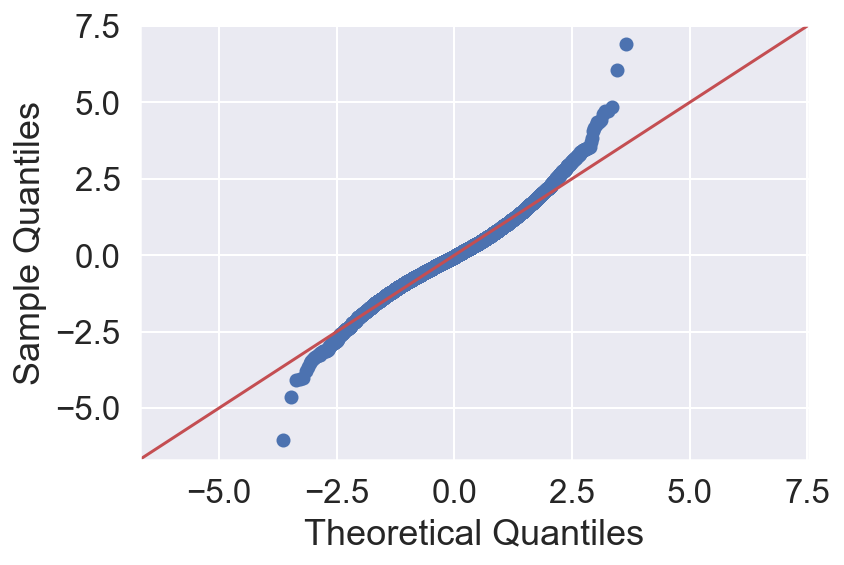

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     179.6173    136.7896
MAE     12.7676    12.2179      10.1374      8.8864
R^2      0.0000    -0.1012       0.3612      0.3162


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 0)x(1, 0, 1, 24)   Log Likelihood              -30175.343

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4995      0.008     61.131      0.000       0.484       0.516
ar.S.L24       0.9996      0.000   7793.612      0.000       0.999       1.000
ma.S.L24      -0.9681      0.003   -295.062      0.000      -0.975      -0.962
sigma2       177.3001      2.134     83.094      0.000     173.118     181.482



QUANTILE PLOT - ALL RESIDUALS


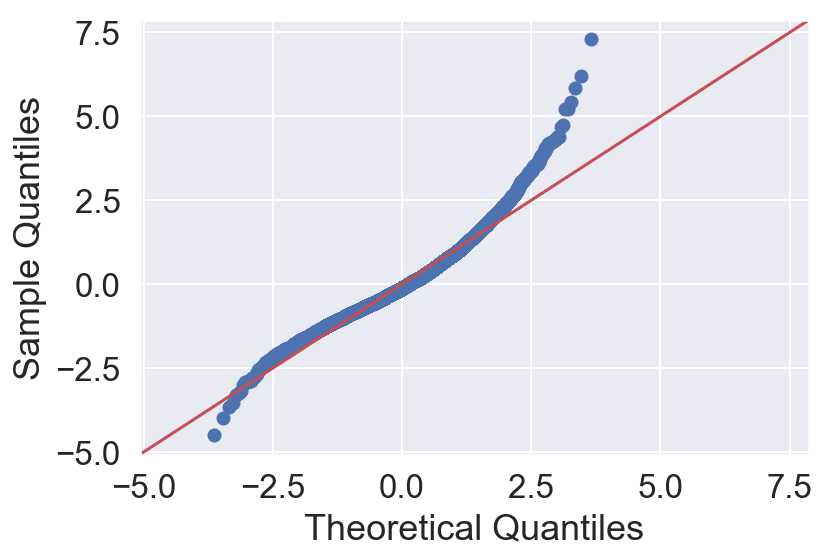

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     179.1835    136.6659
MAE     12.7676    12.2179      10.1242      8.8674
R^2      0.0000    -0.1012       0.3627      0.3169


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 0)x(1, 0, 2, 24)   Log Likelihood              -30167.168

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4948      0.008     59.975      0.000       0.479       0.511
ar.S.L24       0.9995      0.000   6572.083      0.000       0.999       1.000
ma.S.L24      -0.9198      0.010    -88.729      0.000      -0.940      -0.899
ma.S.L48      -0.0478      0.010     -4.610      0.000      -0.068      -0.027
sigma2       176.6157      2.134     82.769      0.000     172.434     180.798



QUANTILE PLOT - ALL RESIDUALS


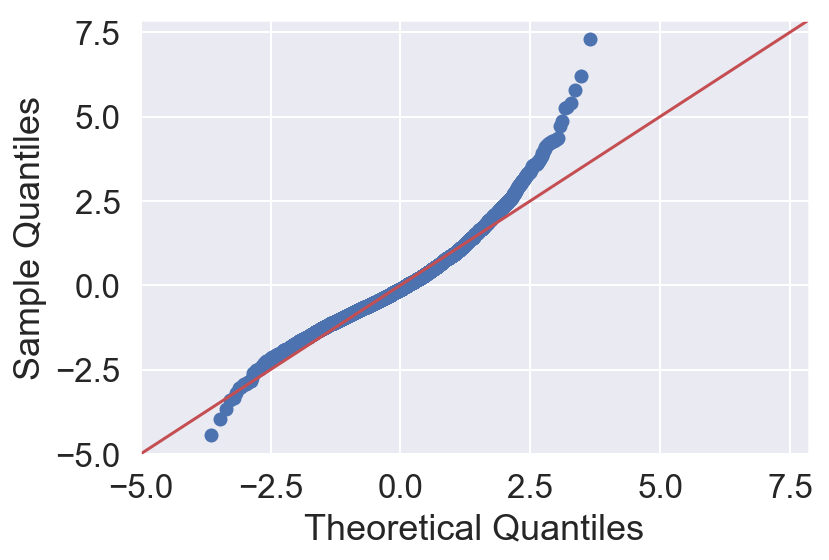

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     221.0740    172.6315
MAE     12.7676    12.2179      11.1108      9.7615
R^2      0.0000    -0.1012       0.2137      0.1371


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 0)x(2, 0, 0, 24)   Log Likelihood              -30987.949

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8068      0.006    134.285      0.000       0.795       0.819
ar.S.L24       0.1523      0.011     14.480      0.000       0.132       0.173
ar.S.L48       0.1394      0.011     12.355      0.000       0.117       0.162
sigma2       220.9471      2.673     82.650      0.000     215.708     226.187



QUANTILE PLOT - ALL RESIDUALS


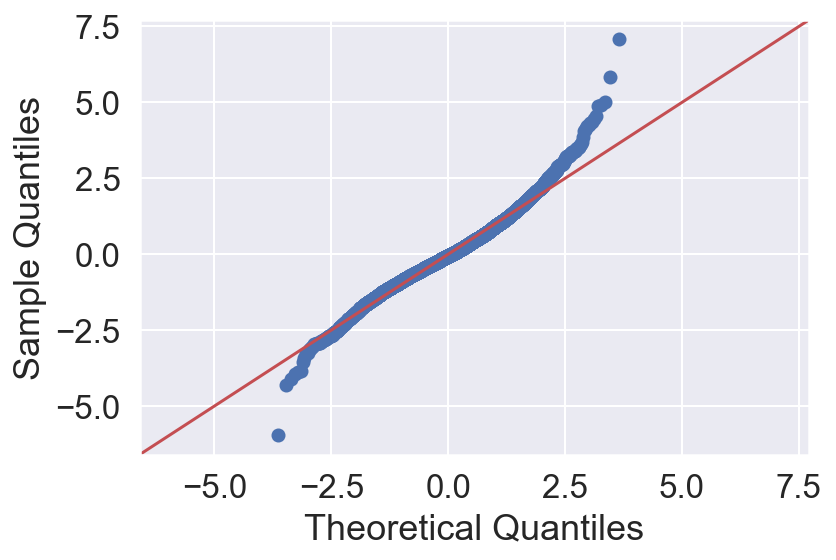

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     179.1645    136.6541
MAE     12.7676    12.2179      10.1260      8.8677
R^2      0.0000    -0.1012       0.3628      0.3169


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 0)x(2, 0, 1, 24)   Log Likelihood              -30166.517

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4943      0.008     59.941      0.000       0.478       0.510
ar.S.L24       1.0505      0.011     98.523      0.000       1.030       1.071
ar.S.L48      -0.0509      0.011     -4.786      0.000      -0.072      -0.030
ma.S.L24      -0.9694      0.003   -279.631      0.000      -0.976      -0.963
sigma2       176.3563      2.128     82.882      0.000     172.186     180.527



QUANTILE PLOT - ALL RESIDUALS


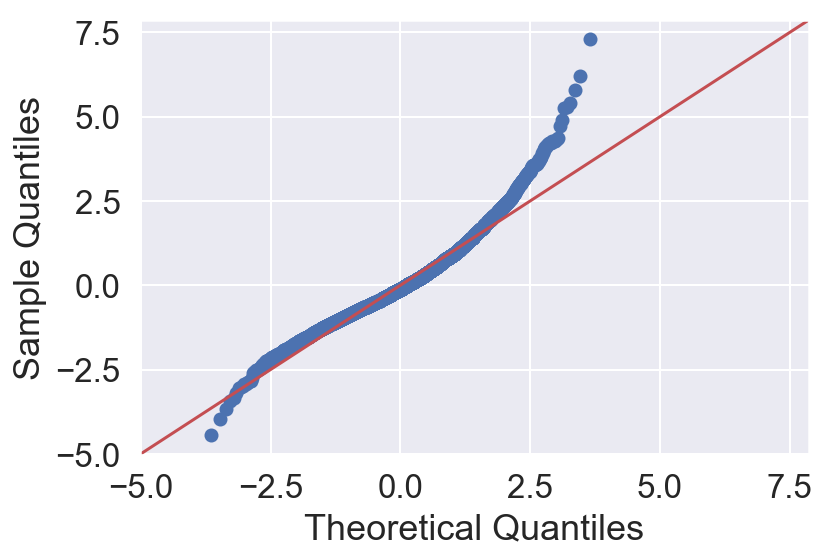

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     179.5895    136.7140
MAE     12.7676    12.2179      10.1339      8.8814
R^2      0.0000    -0.1012       0.3613      0.3166


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 0)x(2, 0, 2, 24)   Log Likelihood              -30174.192

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4996      0.008     61.158      0.000       0.484       0.516
ar.S.L24       0.0456      0.101      0.453      0.650      -0.152       0.243
ar.S.L48       0.9535      0.101      9.473      0.000       0.756       1.151
ma.S.L24      -0.0102      0.098     -0.104      0.917      -0.202       0.182
ma.S.L48      -0.9256      0.094     -9.818      0.000      -1.110      -0.741
sigma2       

QUANTILE PLOT - ALL RESIDUALS


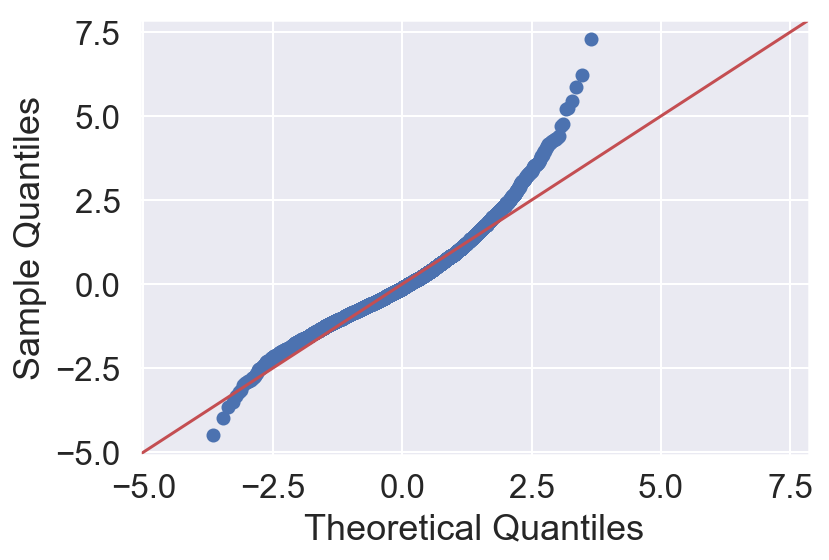

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     201.5487    159.2334
MAE     12.7676    12.2179      10.6367      9.4849
R^2      0.0000    -0.1012       0.2832      0.2041


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(1, 0, 0, 24)   Log Likelihood              -30645.479

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9625      0.003    293.287      0.000       0.956       0.969
ma.L1         -0.4802      0.011    -45.234      0.000      -0.501      -0.459
ar.S.L24       0.1279      0.010     12.236      0.000       0.107       0.148
sigma2       201.4807      2.394     84.163      0.000     196.789     206.173



QUANTILE PLOT - ALL RESIDUALS


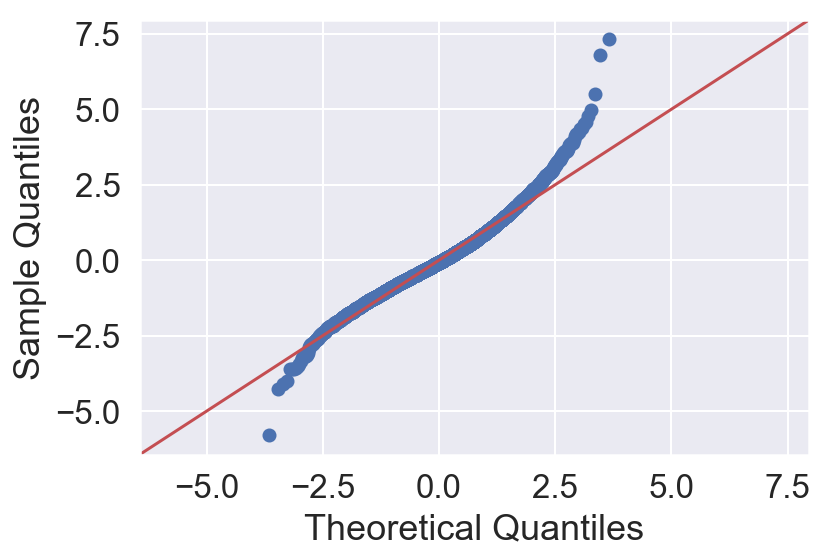

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.9370    136.7769
MAE     12.7676    12.2179      10.0362      8.8930
R^2      0.0000    -0.1012       0.3707      0.3163


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -30129.740

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7047      0.013     52.293      0.000       0.678       0.731
ma.L1         -0.2763      0.018    -14.939      0.000      -0.313      -0.240
ar.S.L24       0.9994      0.000   5773.616      0.000       0.999       1.000
ma.S.L24      -0.9700      0.003   -292.951      0.000      -0.976      -0.964
sigma2       174.5232      2.091     83.451      0.000     170.424     178.622



QUANTILE PLOT - ALL RESIDUALS


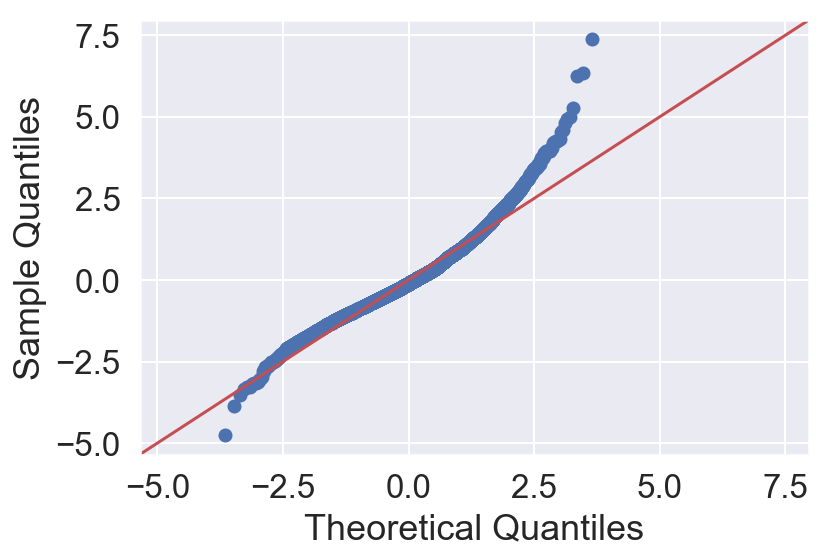

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.6246    136.6156
MAE     12.7676    12.2179      10.0330      8.8777
R^2      0.0000    -0.1012       0.3718      0.3171


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(1, 0, 2, 24)   Log Likelihood              -30123.401

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7049      0.014     51.839      0.000       0.678       0.732
ma.L1         -0.2806      0.019    -15.100      0.000      -0.317      -0.244
ar.S.L24       0.9995      0.000   6184.838      0.000       0.999       1.000
ma.S.L24      -0.9326      0.011    -88.700      0.000      -0.953      -0.912
ma.S.L48      -0.0391      0.010     -3.727      0.000      -0.060      -0.019
sigma2       

QUANTILE PLOT - ALL RESIDUALS


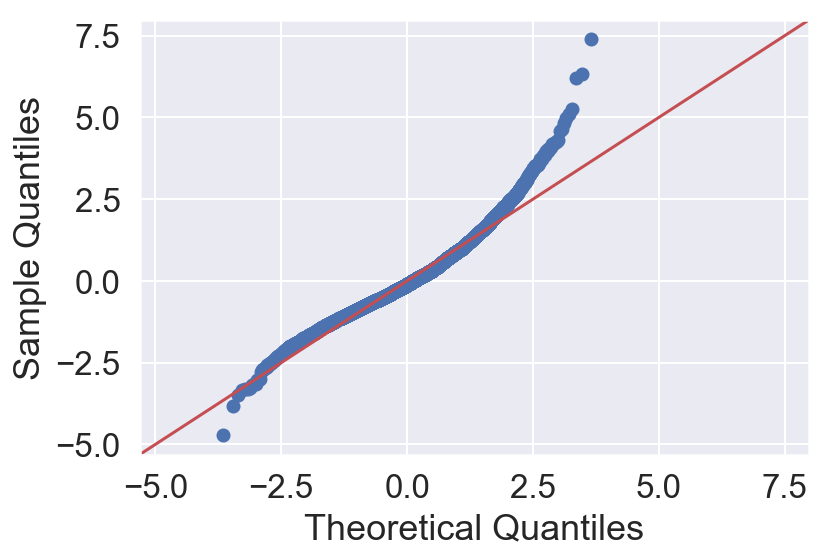

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     199.4595    157.5263
MAE     12.7676    12.2179      10.5759      9.4458
R^2      0.0000    -0.1012       0.2906      0.2126


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(2, 0, 0, 24)   Log Likelihood              -30605.716

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9567      0.004    263.177      0.000       0.950       0.964
ma.L1         -0.4937      0.011    -45.452      0.000      -0.515      -0.472
ar.S.L24       0.1231      0.011     11.630      0.000       0.102       0.144
ar.S.L48       0.1064      0.011      9.876      0.000       0.085       0.128
sigma2       199.3681      2.380     83.769      0.000     194.703     204.033



QUANTILE PLOT - ALL RESIDUALS


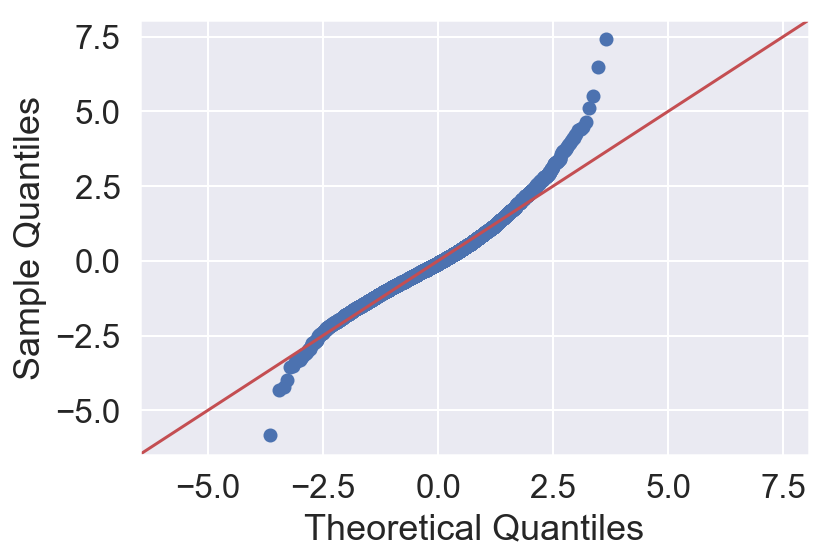

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.6271    136.7024
MAE     12.7676    12.2179      10.0271      8.8722
R^2      0.0000    -0.1012       0.3718      0.3167


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(2, 0, 1, 24)   Log Likelihood              -30124.329

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7045      0.014     51.442      0.000       0.678       0.731
ma.L1         -0.2842      0.019    -15.197      0.000      -0.321      -0.248
ar.S.L24       1.0421      0.011     96.308      0.000       1.021       1.063
ar.S.L48      -0.0428      0.011     -3.962      0.000      -0.064      -0.022
ma.S.L24      -0.9702      0.004   -274.137      0.000      -0.977      -0.963
sigma2       

QUANTILE PLOT - ALL RESIDUALS


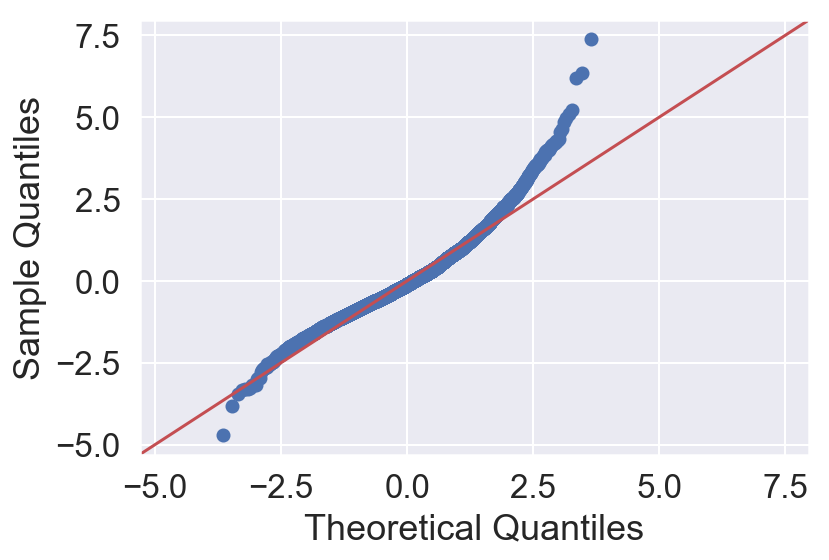

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.9288    136.6419
MAE     12.7676    12.2179      10.0390      8.8910
R^2      0.0000    -0.1012       0.3707      0.3170


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(2, 0, 2, 24)   Log Likelihood              -30128.914

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7052      0.014     52.117      0.000       0.679       0.732
ma.L1         -0.2801      0.019    -15.066      0.000      -0.317      -0.244
ar.S.L24       0.0476      0.122      0.391      0.696      -0.191       0.286
ar.S.L48       0.9514      0.122      7.812      0.000       0.713       1.190
ma.S.L24      -0.0166      0.119     -0.139      0.889      -0.250       0.217
ma.S.L48     

QUANTILE PLOT - ALL RESIDUALS


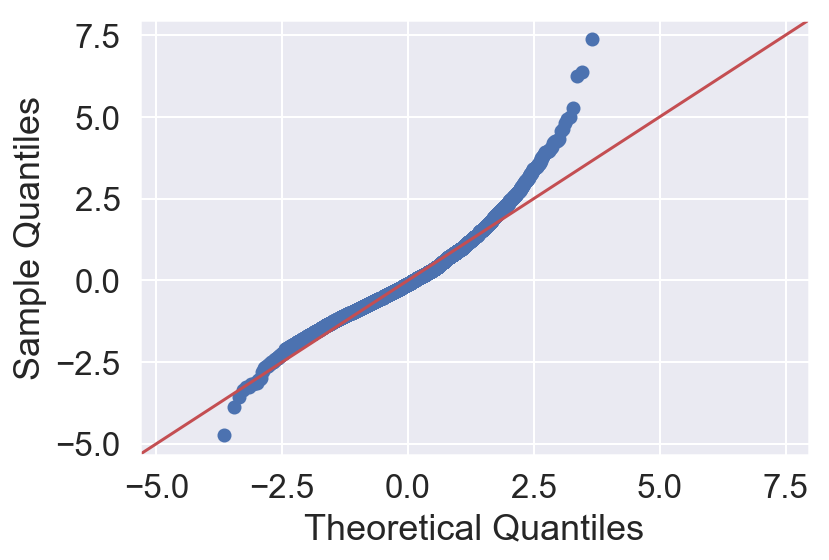

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     193.6156    152.1635
MAE     12.7676    12.2179      10.6243      9.4025
R^2      0.0000    -0.1012       0.3114      0.2394


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(1, 0, 0, 24)   Log Likelihood              -30490.348

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9955      0.001    801.543      0.000       0.993       0.998
ma.L1         -0.5260      0.010    -53.791      0.000      -0.545      -0.507
ma.L2         -0.3047      0.010    -30.866      0.000      -0.324      -0.285
ar.S.L24       0.1455      0.010     14.013      0.000       0.125       0.166
sigma2       193.5158      2.562     75.527      0.000     188.494     198.538



QUANTILE PLOT - ALL RESIDUALS


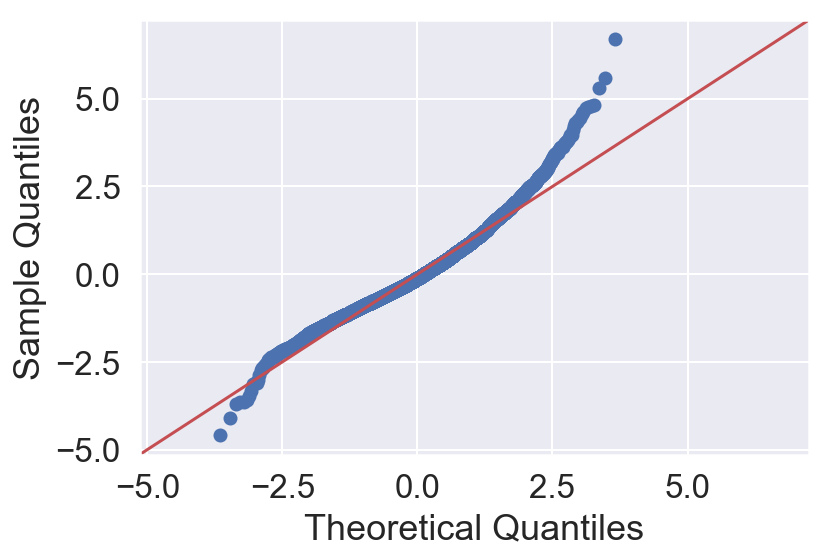

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     175.6121    135.8752
MAE     12.7676    12.2179      10.0255      8.8811
R^2      0.0000    -0.1012       0.3754      0.3208


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(1, 0, 1, 24)   Log Likelihood              -30103.410

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8389      0.014     59.339      0.000       0.811       0.867
ma.L1         -0.4016      0.018    -22.172      0.000      -0.437      -0.366
ma.L2         -0.1311      0.014     -9.491      0.000      -0.158      -0.104
ar.S.L24       0.9993      0.000   4903.171      0.000       0.999       1.000
ma.S.L24      -0.9718      0.003   -294.838      0.000      -0.978      -0.965
sigma2       

QUANTILE PLOT - ALL RESIDUALS


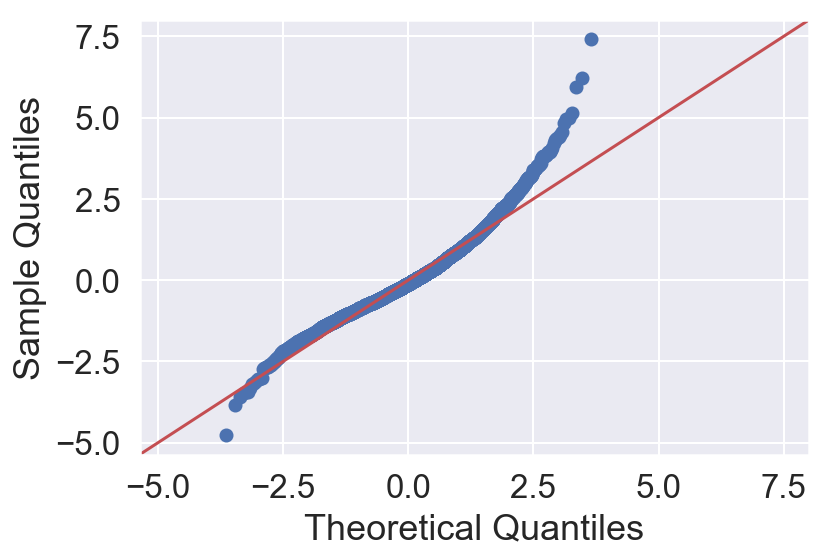

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     175.3435    135.5047
MAE     12.7676    12.2179      10.0363      8.8772
R^2      0.0000    -0.1012       0.3764      0.3227


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(1, 0, 2, 24)   Log Likelihood              -30095.922

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8363      0.014     57.688      0.000       0.808       0.865
ma.L1         -0.4025      0.018    -21.889      0.000      -0.438      -0.366
ma.L2         -0.1313      0.014     -9.531      0.000      -0.158      -0.104
ar.S.L24       0.9997      0.000   8654.504      0.000       0.999       1.000
ma.S.L24      -0.9336      0.011    -88.808      0.000      -0.954      -0.913
ma.S.L48     

QUANTILE PLOT - ALL RESIDUALS


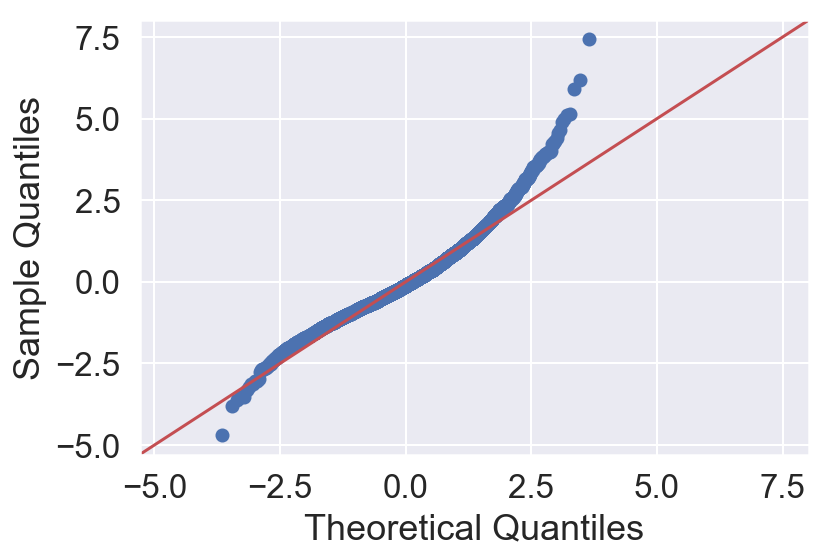

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     191.5820    150.4449
MAE     12.7676    12.2179      10.5395      9.3511
R^2      0.0000    -0.1012       0.3186      0.2480


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(2, 0, 0, 24)   Log Likelihood              -30449.833

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9937      0.001    663.943      0.000       0.991       0.997
ma.L1         -0.5296      0.010    -52.925      0.000      -0.549      -0.510
ma.L2         -0.2882      0.010    -28.772      0.000      -0.308      -0.269
ar.S.L24       0.1327      0.011     12.573      0.000       0.112       0.153
ar.S.L48       0.1043      0.011      9.723      0.000       0.083       0.125
sigma2       

QUANTILE PLOT - ALL RESIDUALS


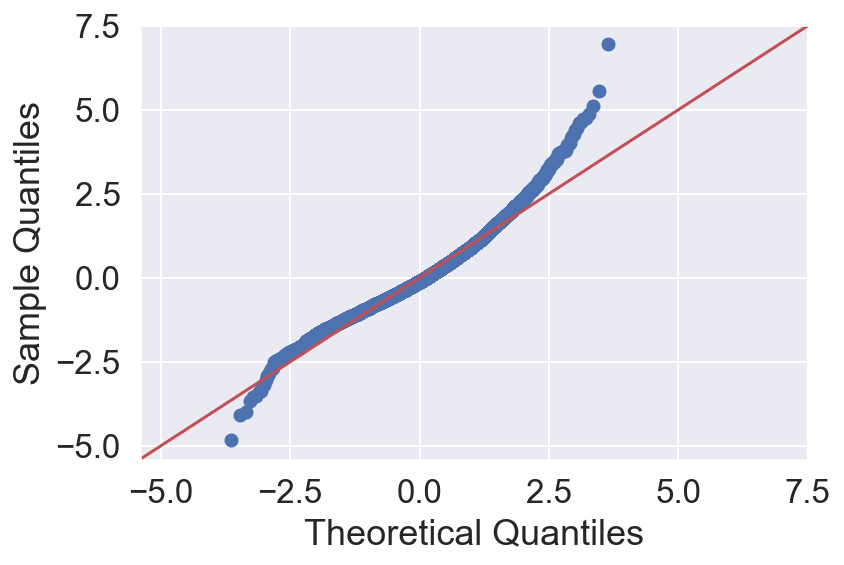

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     175.2805    135.7384
MAE     12.7676    12.2179      10.0185      8.8674
R^2      0.0000    -0.1012       0.3766      0.3215


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(2, 0, 1, 24)   Log Likelihood              -30097.771

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8445      0.014     60.145      0.000       0.817       0.872
ma.L1         -0.4100      0.018    -22.731      0.000      -0.445      -0.375
ma.L2         -0.1364      0.014     -9.922      0.000      -0.163      -0.109
ar.S.L24       1.0438      0.011     96.758      0.000       1.023       1.065
ar.S.L48      -0.0444      0.011     -4.133      0.000      -0.065      -0.023
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


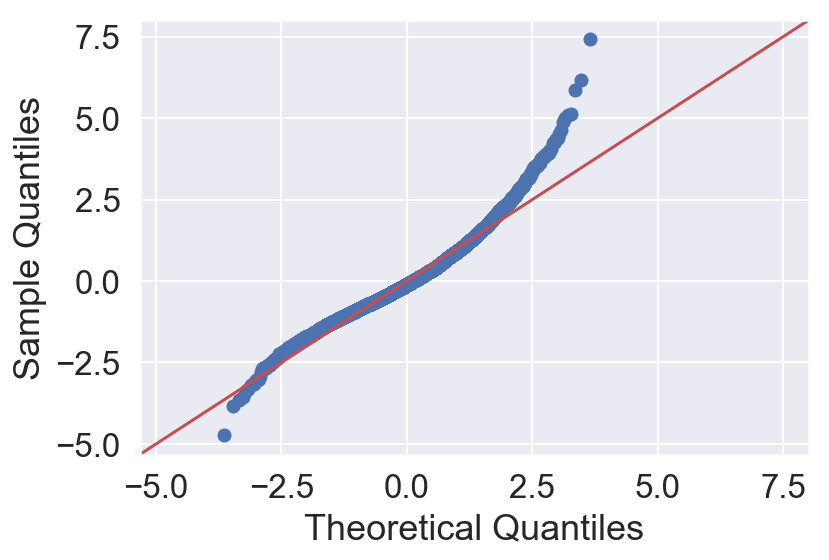

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.2514    135.5591
MAE     12.7676    12.2179      10.0919      8.9244
R^2      0.0000    -0.1012       0.3731      0.3224


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(2, 0, 2, 24)   Log Likelihood              -30109.998

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8575      0.008    103.923      0.000       0.841       0.874
ma.L1         -0.4218      0.013    -33.346      0.000      -0.447      -0.397
ma.L2         -0.1474      0.006    -26.790      0.000      -0.158      -0.137
ar.S.L24       0.0163      0.006      2.577      0.010       0.004       0.029
ar.S.L48       0.9835      0.006    155.941      0.000       0.971       0.996
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


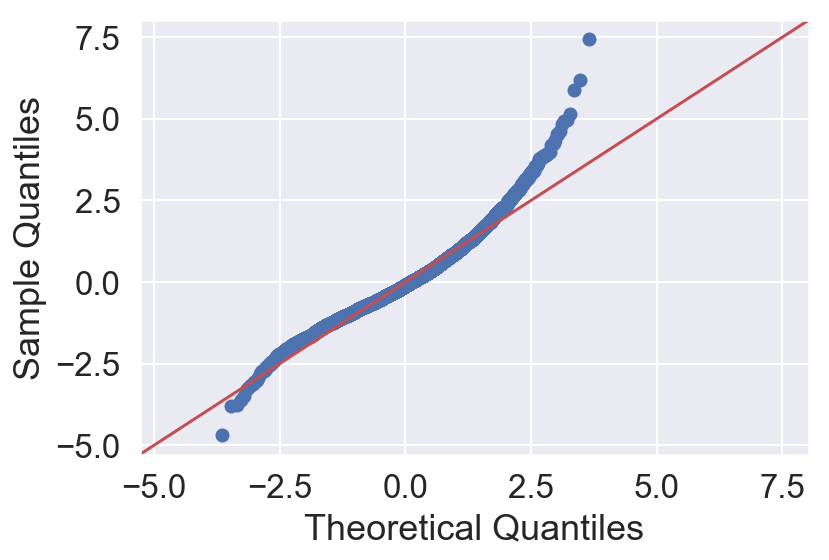

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     210.4017    166.2651
MAE     12.7676    12.2179      10.8172      9.5994
R^2      0.0000    -0.1012       0.2517      0.1689


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 0)x(1, 0, 0, 24)   Log Likelihood              -30808.168

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6494      0.009     69.500      0.000       0.631       0.668
ar.L2          0.2454      0.010     24.556      0.000       0.226       0.265
ar.S.L24       0.1109      0.010     10.658      0.000       0.090       0.131
sigma2       210.3376      2.495     84.315      0.000     205.448     215.227



QUANTILE PLOT - ALL RESIDUALS


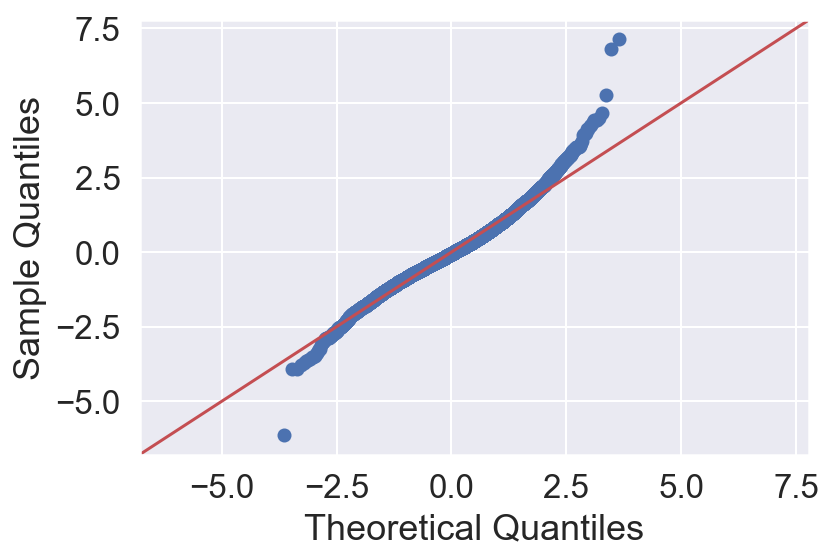

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     177.8167    136.7143
MAE     12.7676    12.2179      10.0655      8.8846
R^2      0.0000    -0.1012       0.3676      0.3166


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 0)x(1, 0, 1, 24)   Log Likelihood              -30144.244

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4527      0.010     47.230      0.000       0.434       0.471
ar.L2          0.0981      0.010      9.585      0.000       0.078       0.118
ar.S.L24       0.9995      0.000   6381.101      0.000       0.999       1.000
ma.S.L24      -0.9688      0.003   -291.400      0.000      -0.975      -0.962
sigma2       175.3815      2.102     83.432      0.000     171.261     179.502



QUANTILE PLOT - ALL RESIDUALS


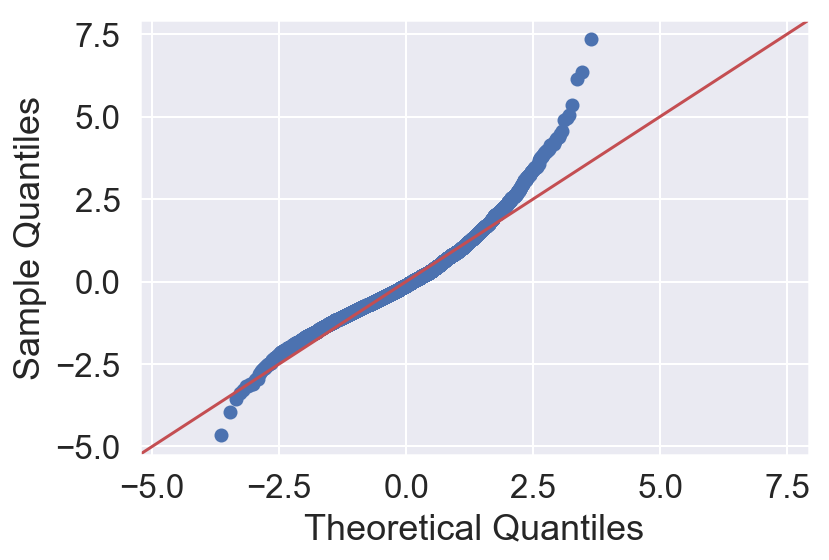

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     177.4804    136.5634
MAE     12.7676    12.2179      10.0608      8.8682
R^2      0.0000    -0.1012       0.3688      0.3174


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 0)x(1, 0, 2, 24)   Log Likelihood              -30137.379

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4490      0.010     46.923      0.000       0.430       0.468
ar.L2          0.0979      0.010      9.610      0.000       0.078       0.118
ar.S.L24       0.9995      0.000   6286.421      0.000       0.999       1.000
ma.S.L24      -0.9279      0.010    -88.742      0.000      -0.948      -0.907
ma.S.L48      -0.0415      0.010     -3.980      0.000      -0.062      -0.021
sigma2       

QUANTILE PLOT - ALL RESIDUALS


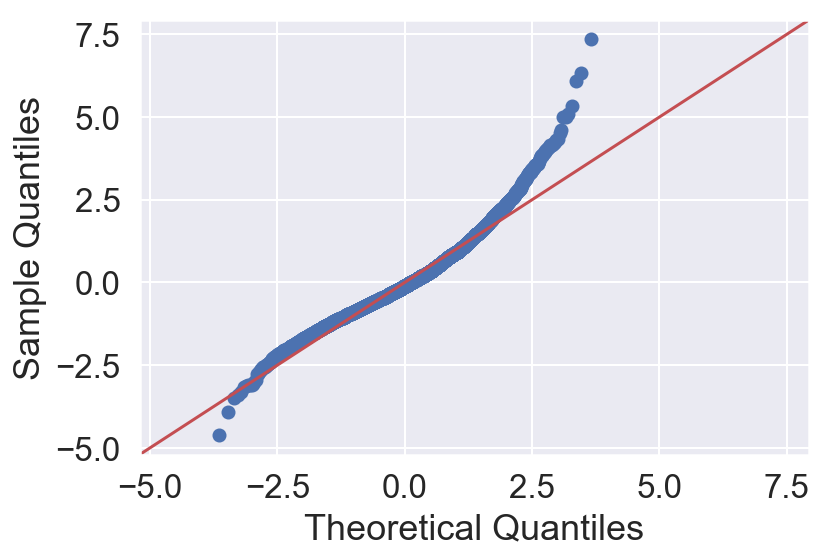

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     208.3814    164.5852
MAE     12.7676    12.2179      10.7554      9.5487
R^2      0.0000    -0.1012       0.2589      0.1773


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 0)x(2, 0, 0, 24)   Log Likelihood              -30771.220

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6298      0.010     65.977      0.000       0.611       0.649
ar.L2          0.2415      0.010     23.803      0.000       0.222       0.261
ar.S.L24       0.1164      0.011     11.068      0.000       0.096       0.137
ar.S.L48       0.1074      0.011      9.755      0.000       0.086       0.129
sigma2       208.2923      2.473     84.233      0.000     203.446     213.139



QUANTILE PLOT - ALL RESIDUALS


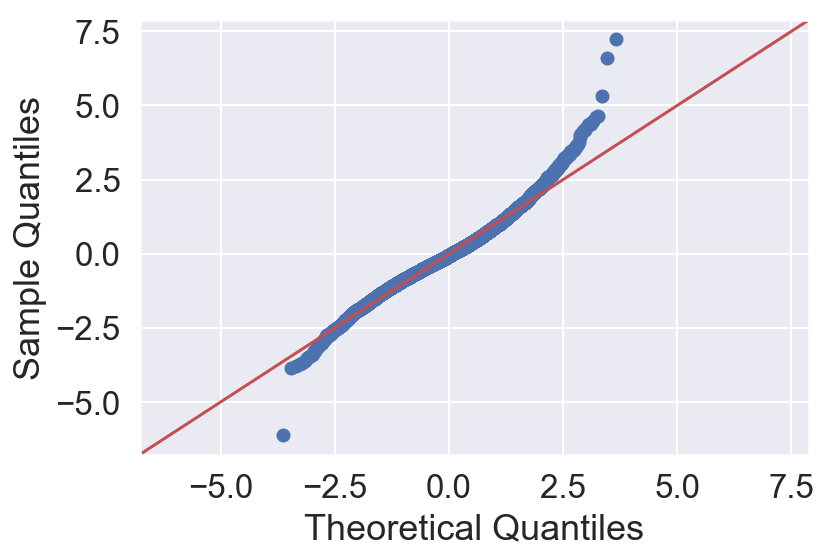

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     177.4827    136.4143
MAE     12.7676    12.2179      10.0701      8.8710
R^2      0.0000    -0.1012       0.3688      0.3181


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 0)x(2, 0, 1, 24)   Log Likelihood              -30136.521

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4498      0.010     46.992      0.000       0.431       0.469
ar.L2          0.0957      0.010      9.393      0.000       0.076       0.116
ar.S.L24       1.0472      0.011     97.932      0.000       1.026       1.068
ar.S.L48      -0.0475      0.011     -4.449      0.000      -0.068      -0.027
ma.S.L24      -0.9741      0.003   -300.846      0.000      -0.980      -0.968
sigma2       

QUANTILE PLOT - ALL RESIDUALS


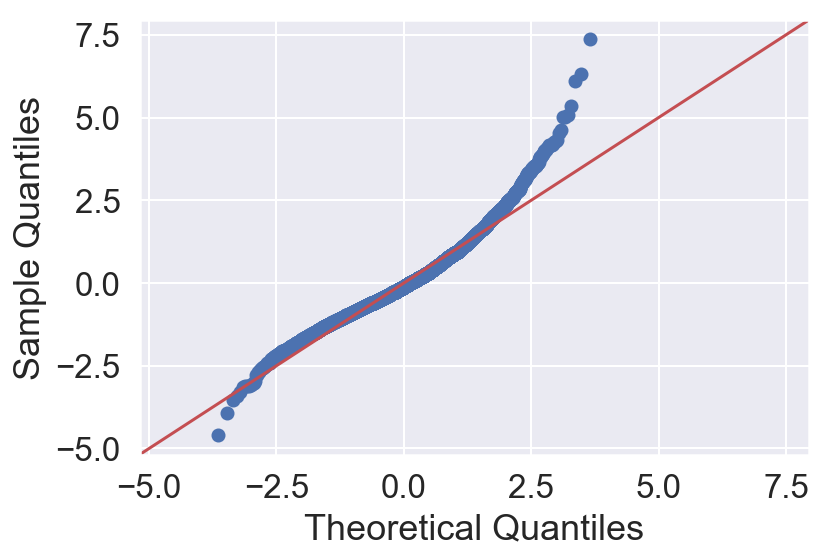

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     177.8076    136.6071
MAE     12.7676    12.2179      10.0668      8.8828
R^2      0.0000    -0.1012       0.3676      0.3172


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 0)x(2, 0, 2, 24)   Log Likelihood              -30143.527

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4527      0.010     47.199      0.000       0.434       0.471
ar.L2          0.0979      0.010      9.561      0.000       0.078       0.118
ar.S.L24       0.0448      0.131      0.341      0.733      -0.213       0.302
ar.S.L48       0.9543      0.131      7.261      0.000       0.697       1.212
ma.S.L24      -0.0123      0.129     -0.096      0.924      -0.265       0.240
ma.S.L48     

QUANTILE PLOT - ALL RESIDUALS


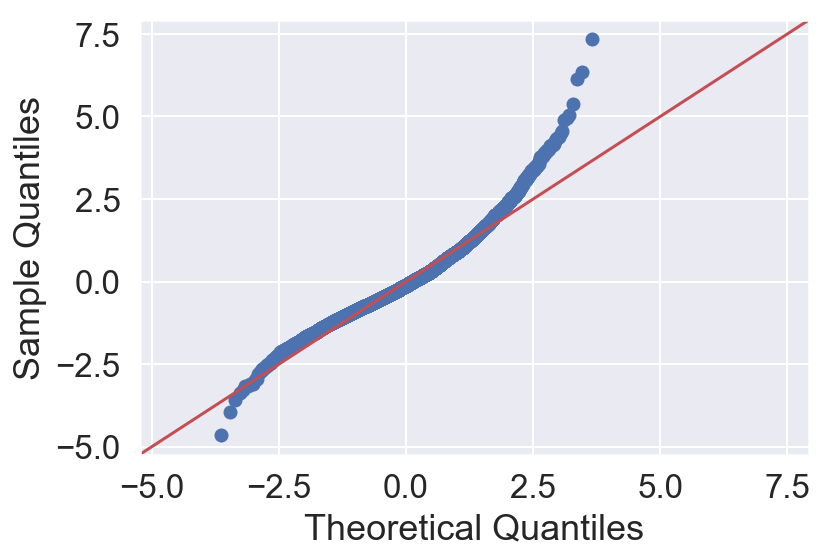

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     182.8647    143.4652
MAE     12.7676    12.2179      10.3279      9.1140
R^2      0.0000    -0.1012       0.3496      0.2829


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(1, 0, 0, 24)   Log Likelihood              -30272.745

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.5005      0.009    170.274      0.000       1.483       1.518
ar.L2         -0.5006      0.009    -56.754      0.000      -0.518      -0.483
ma.L1         -0.9874      0.002   -579.215      0.000      -0.991      -0.984
ar.S.L24       0.1081      0.010     10.542      0.000       0.088       0.128
sigma2       182.7251      2.349     77.778      0.000     178.121     187.330



QUANTILE PLOT - ALL RESIDUALS


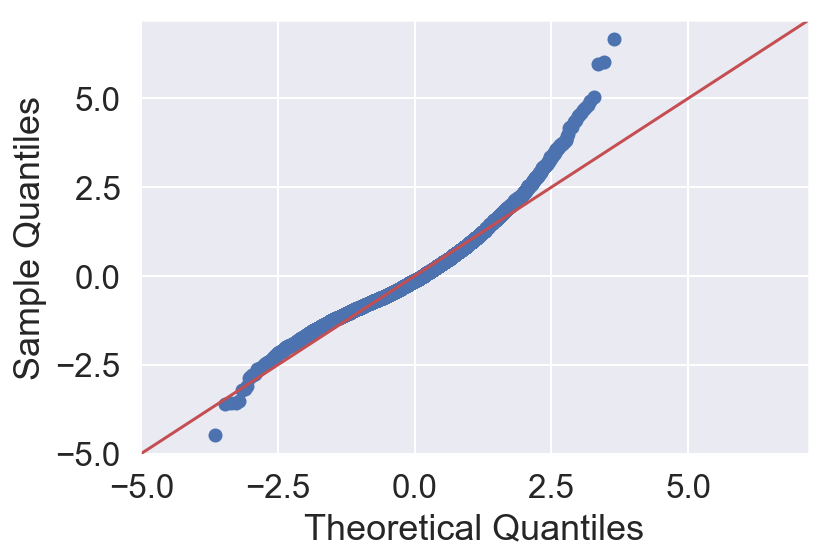

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.8203    136.4827
MAE     12.7676    12.2179       9.9781      8.9081
R^2      0.0000    -0.1012       0.3818      0.3178


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -30078.094

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4073      0.010    138.337      0.000       1.387       1.427
ar.L2         -0.4133      0.010    -41.874      0.000      -0.433      -0.394
ma.L1         -0.9537      0.005   -177.394      0.000      -0.964      -0.943
ar.S.L24       0.9972      0.001   1238.912      0.000       0.996       0.999
ma.S.L24      -0.9705      0.004   -248.407      0.000      -0.978      -0.963
sigma2       

QUANTILE PLOT - ALL RESIDUALS


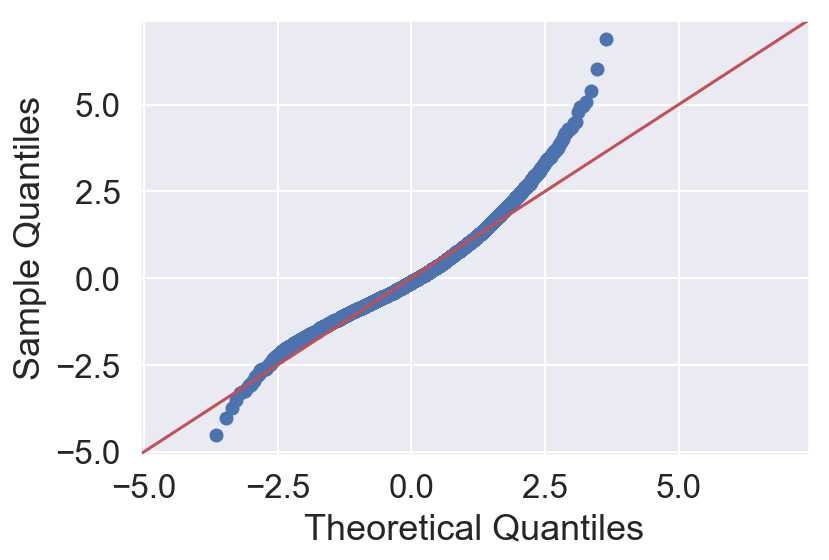

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.5314    136.1149
MAE     12.7676    12.2179       9.9809      8.8928
R^2      0.0000    -0.1012       0.3828      0.3196


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(1, 0, 2, 24)   Log Likelihood              -30070.685

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4116      0.011    125.504      0.000       1.390       1.434
ar.L2         -0.4164      0.010    -40.040      0.000      -0.437      -0.396
ma.L1         -0.9592      0.006   -171.047      0.000      -0.970      -0.948
ar.S.L24       0.9983      0.001   1729.999      0.000       0.997       0.999
ma.S.L24      -0.9492      0.007   -138.848      0.000      -0.963      -0.936
ma.S.L48     

QUANTILE PLOT - ALL RESIDUALS


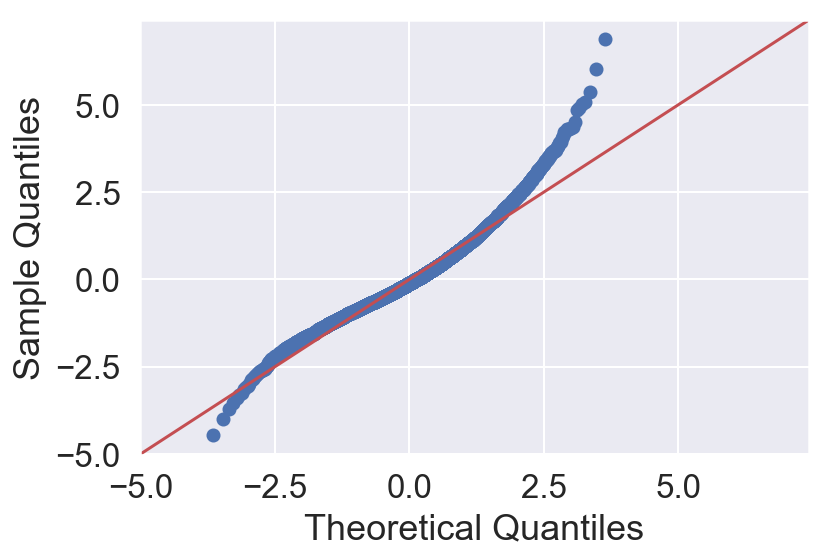

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     181.9860    142.7410
MAE     12.7676    12.2179      10.2983      9.1050
R^2      0.0000    -0.1012       0.3527      0.2865


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(2, 0, 0, 24)   Log Likelihood              -30254.360

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4953      0.009    169.125      0.000       1.478       1.513
ar.L2         -0.4954      0.009    -55.978      0.000      -0.513      -0.478
ma.L1         -0.9881      0.002   -593.013      0.000      -0.991      -0.985
ar.S.L24       0.1022      0.010      9.848      0.000       0.082       0.123
ar.S.L48       0.0701      0.011      6.589      0.000       0.049       0.091
sigma2       

QUANTILE PLOT - ALL RESIDUALS


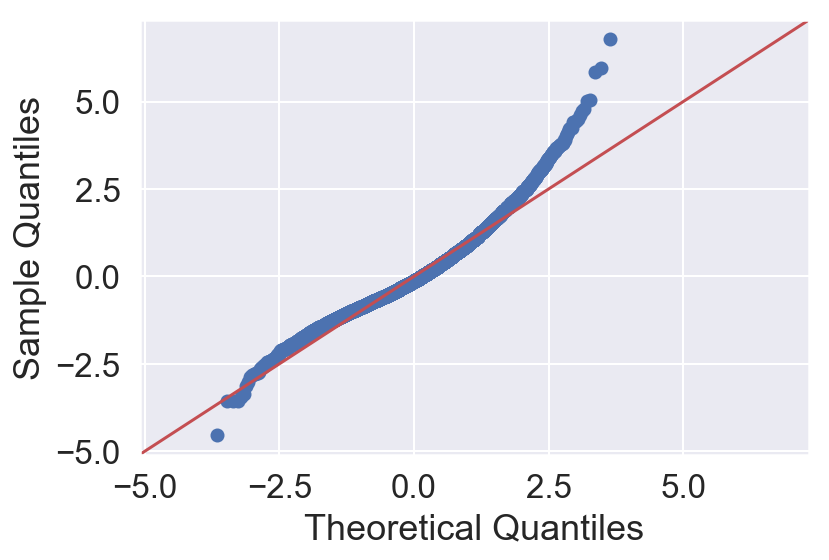

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.5513    136.1408
MAE     12.7676    12.2179       9.9787      8.8919
R^2      0.0000    -0.1012       0.3827      0.3195


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(2, 0, 1, 24)   Log Likelihood              -30071.209

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4119      0.012    121.321      0.000       1.389       1.435
ar.L2         -0.4169      0.011    -38.209      0.000      -0.438      -0.396
ma.L1         -0.9588      0.006   -169.125      0.000      -0.970      -0.948
ar.S.L24       1.0262      0.004    254.440      0.000       1.018       1.034
ar.S.L48      -0.0280      0.004     -6.925      0.000      -0.036      -0.020
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


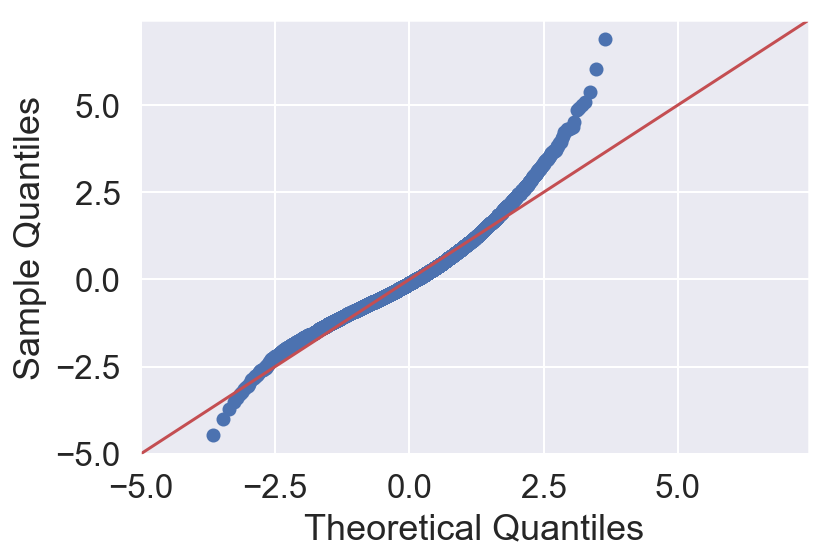

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.8925    136.1123
MAE     12.7676    12.2179       9.9787      8.8980
R^2      0.0000    -0.1012       0.3815      0.3196


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(2, 0, 2, 24)   Log Likelihood              -30076.946

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3888      0.013    102.885      0.000       1.362       1.415
ar.L2         -0.3991      0.012    -33.050      0.000      -0.423      -0.375
ma.L1         -0.9391      0.008   -115.378      0.000      -0.955      -0.923
ar.S.L24       0.1106      0.013      8.422      0.000       0.085       0.136
ar.S.L48       0.8862      0.013     66.215      0.000       0.860       0.912
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


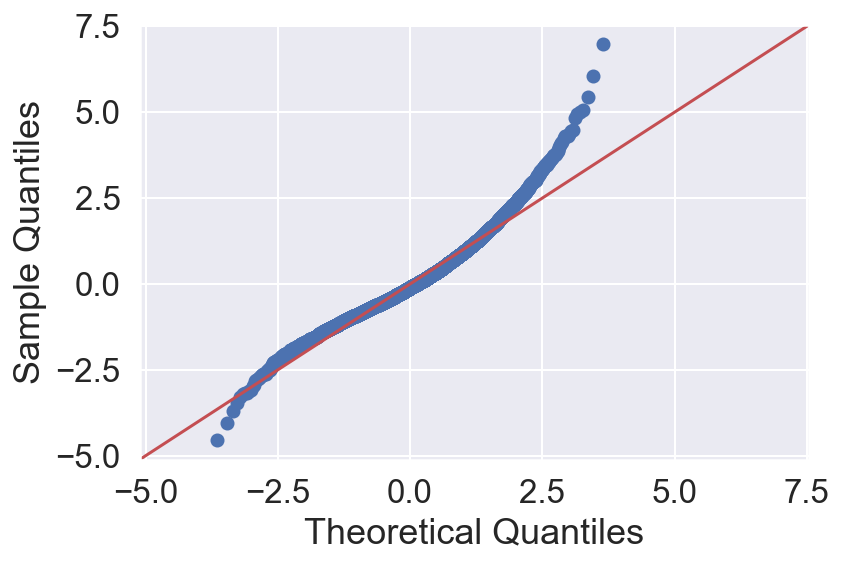

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     181.9370    142.9960
MAE     12.7676    12.2179      10.2855      9.0872
R^2      0.0000    -0.1012       0.3529      0.2852


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(1, 0, 0, 24)   Log Likelihood              -30254.580

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.6185      0.016    101.277      0.000       1.587       1.650
ar.L2         -0.6185      0.016    -38.700      0.000      -0.650      -0.587
ma.L1         -1.1443      0.020    -57.822      0.000      -1.183      -1.106
ma.L2          0.1526      0.019      7.872      0.000       0.115       0.191
ar.S.L24       0.1093      0.010     10.630      0.000       0.089       0.129
sigma2       

QUANTILE PLOT - ALL RESIDUALS


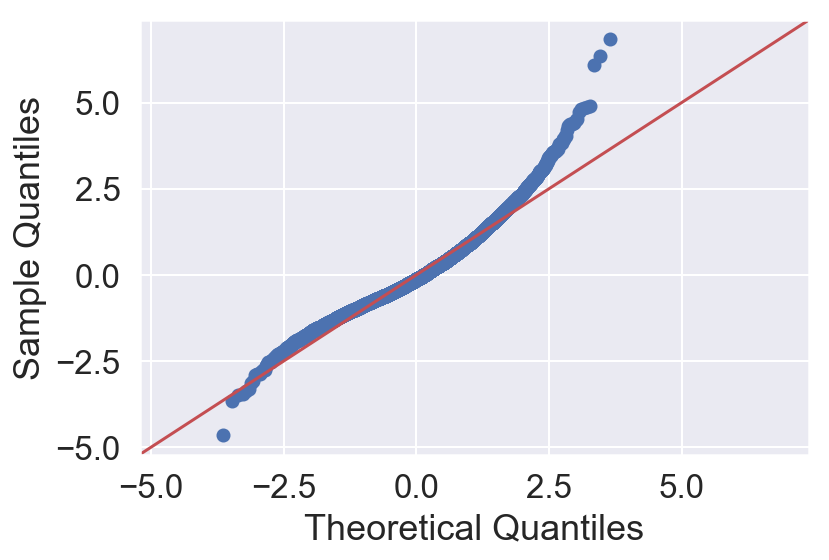

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     174.2649    136.4179
MAE     12.7676    12.2179       9.9563      8.8730
R^2      0.0000    -0.1012       0.3802      0.3181


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(1, 0, 1, 24)   Log Likelihood              -30090.549

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4472      0.027     54.519      0.000       1.395       1.499
ar.L2         -0.4575      0.025    -18.483      0.000      -0.506      -0.409
ma.L1         -1.0464      0.028    -37.741      0.000      -1.101      -0.992
ma.L2          0.0986      0.023      4.344      0.000       0.054       0.143
ar.S.L24       0.9972      0.001   1350.764      0.000       0.996       0.999
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


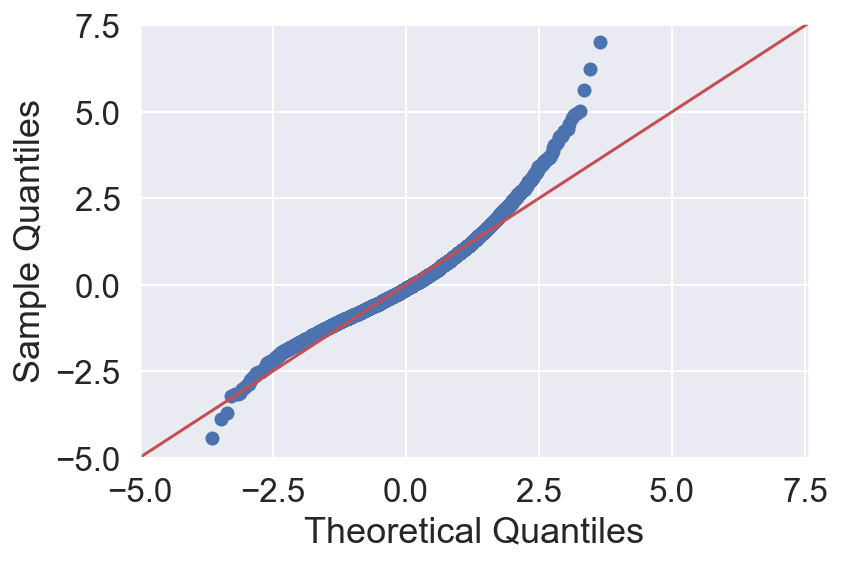

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.1590    135.8687
MAE     12.7676    12.2179       9.9548      8.8757
R^2      0.0000    -0.1012       0.3841      0.3208


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(1, 0, 2, 24)   Log Likelihood              -30061.465

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.5075      0.012    120.850      0.000       1.483       1.532
ar.L2         -0.5132      0.012    -44.259      0.000      -0.536      -0.490
ma.L1         -1.0784      0.009   -116.772      0.000      -1.096      -1.060
ma.L2          0.1153      0.007     17.541      0.000       0.102       0.128
ar.S.L24       0.9986      0.000   2101.008      0.000       0.998       1.000
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


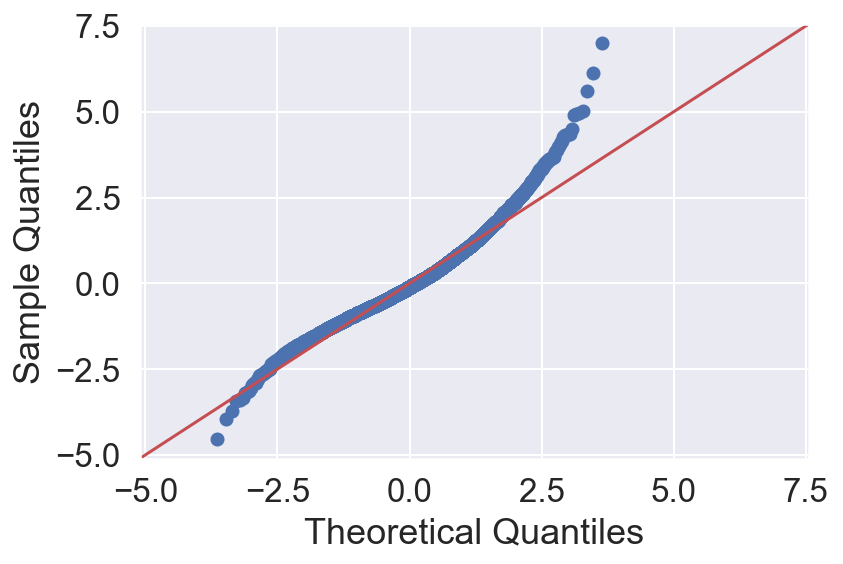

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     180.9602    142.2123
MAE     12.7676    12.2179      10.2512      9.0759
R^2      0.0000    -0.1012       0.3564      0.2891


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(2, 0, 0, 24)   Log Likelihood              -30234.504

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.6217      0.016    100.956      0.000       1.590       1.653
ar.L2         -0.6218      0.016    -38.702      0.000      -0.653      -0.590
ma.L1         -1.1544      0.020    -57.439      0.000      -1.194      -1.115
ma.L2          0.1616      0.020      8.195      0.000       0.123       0.200
ar.S.L24       0.1035      0.010      9.907      0.000       0.083       0.124
ar.S.L48     

QUANTILE PLOT - ALL RESIDUALS


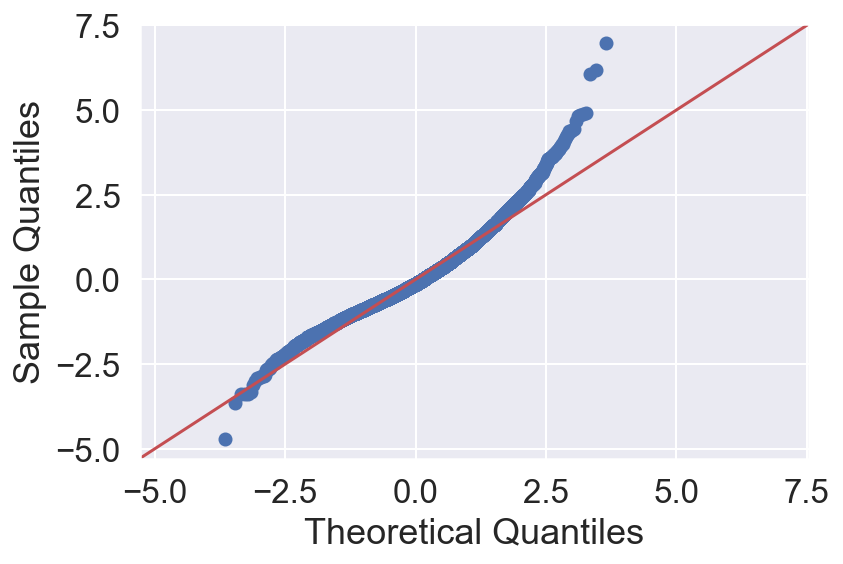

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.1480    135.7950
MAE     12.7676    12.2179       9.9551      8.8732
R^2      0.0000    -0.1012       0.3842      0.3212


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(2, 0, 1, 24)   Log Likelihood              -30061.322

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.5097      0.026     58.402      0.000       1.459       1.560
ar.L2         -0.5152      0.025    -20.687      0.000      -0.564      -0.466
ma.L1         -1.0813      0.028    -38.358      0.000      -1.137      -1.026
ma.L2          0.1164      0.024      4.876      0.000       0.070       0.163
ar.S.L24       1.0300      0.007    153.915      0.000       1.017       1.043
ar.S.L48     

QUANTILE PLOT - ALL RESIDUALS


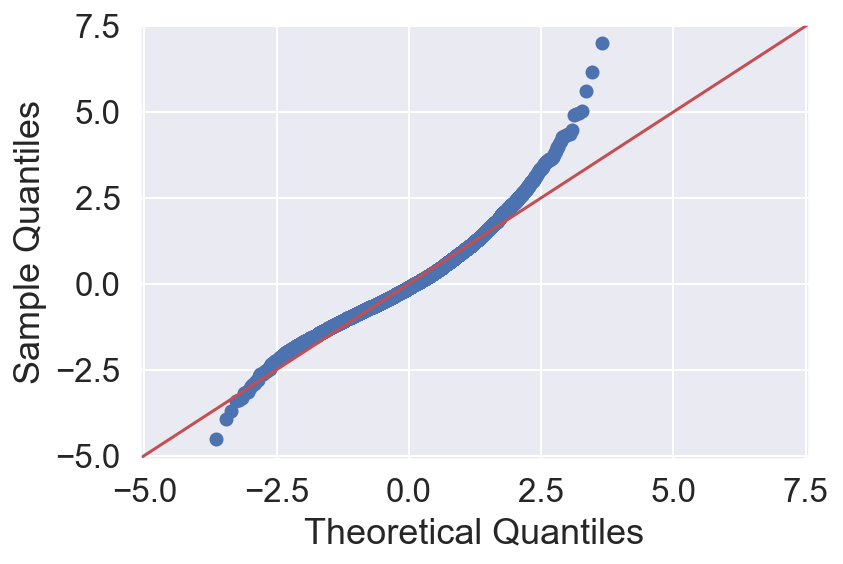

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     174.2863    135.9555
MAE     12.7676    12.2179       9.9866      8.8848
R^2      0.0000    -0.1012       0.3801      0.3204


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(2, 0, 2, 24)   Log Likelihood              -30081.938

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3801      0.040     34.674      0.000       1.302       1.458
ar.L2         -0.4040      0.036    -11.324      0.000      -0.474      -0.334
ma.L1         -0.9438      0.041    -22.916      0.000      -1.025      -0.863
ma.L2          0.0420      0.028      1.496      0.135      -0.013       0.097
ar.S.L24       0.0882      0.007     12.147      0.000       0.074       0.102
ar.S.L48     

QUANTILE PLOT - ALL RESIDUALS


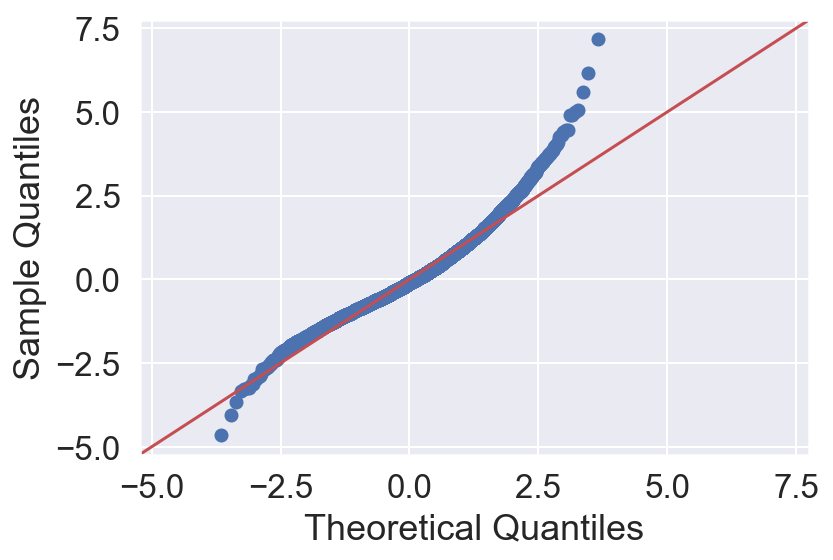

In [14]:
season=24
freq='H'
lag=[1,2]
ma=[0,1,2]

for olag in lag:
    for oma in ma:
        for solag in lag:
            for soma in ma:
                model_test(all_traffic.all_games_count,olag,oma,solag,soma,season,freq)
 

Performance is better with at least one moving average

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.9370    136.7769
MAE     12.7676    12.2179      10.0362      8.8930
R^2      0.0000    -0.1012       0.3707      0.3163


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -30129.740

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7047      0.013     52.293      0.000       0.678       0.731
ma.L1         -0.2763      0.018    -14.939      0.000      -0.313      -0.240
ar.S.L24       0.9994      0.000   5773.616      0.000       0.999       1.000
ma.S.L24      -0.9700      0.003   -292.951      0.000      -0.976      -0.964
sigma2       174.5232      2.091     83.451      0.000     170.424     178.622



QUANTILE PLOT - ALL RESIDUALS


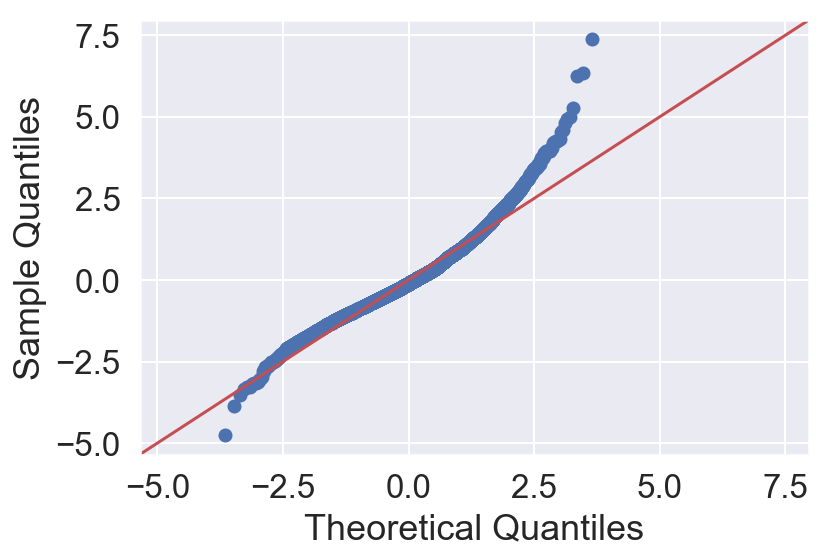

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     175.6121    135.8752
MAE     12.7676    12.2179      10.0255      8.8811
R^2      0.0000    -0.1012       0.3754      0.3208


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(1, 0, 1, 24)   Log Likelihood              -30103.410

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8389      0.014     59.339      0.000       0.811       0.867
ma.L1         -0.4016      0.018    -22.172      0.000      -0.437      -0.366
ma.L2         -0.1311      0.014     -9.491      0.000      -0.158      -0.104
ar.S.L24       0.9993      0.000   4903.171      0.000       0.999       1.000
ma.S.L24      -0.9718      0.003   -294.838      0.000      -0.978      -0.965
sigma2       

QUANTILE PLOT - ALL RESIDUALS


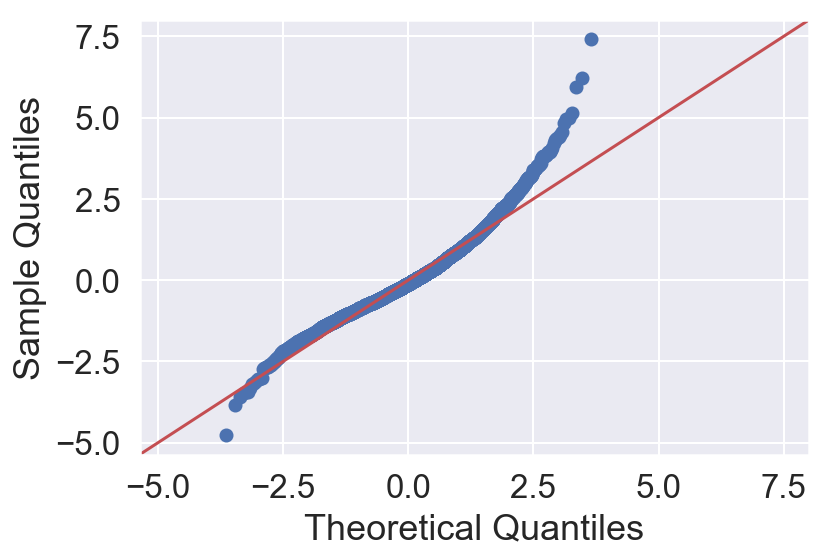

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.8203    136.4827
MAE     12.7676    12.2179       9.9781      8.9081
R^2      0.0000    -0.1012       0.3818      0.3178


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -30078.094

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4073      0.010    138.337      0.000       1.387       1.427
ar.L2         -0.4133      0.010    -41.874      0.000      -0.433      -0.394
ma.L1         -0.9537      0.005   -177.394      0.000      -0.964      -0.943
ar.S.L24       0.9972      0.001   1238.912      0.000       0.996       0.999
ma.S.L24      -0.9705      0.004   -248.407      0.000      -0.978      -0.963
sigma2       

QUANTILE PLOT - ALL RESIDUALS


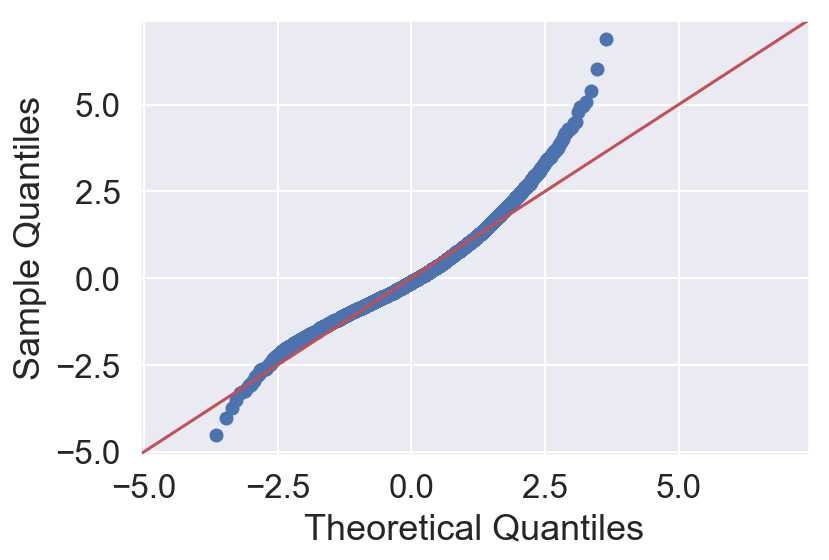

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     174.2649    136.4179
MAE     12.7676    12.2179       9.9563      8.8730
R^2      0.0000    -0.1012       0.3802      0.3181


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(1, 0, 1, 24)   Log Likelihood              -30090.549

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4472      0.027     54.519      0.000       1.395       1.499
ar.L2         -0.4575      0.025    -18.483      0.000      -0.506      -0.409
ma.L1         -1.0464      0.028    -37.741      0.000      -1.101      -0.992
ma.L2          0.0986      0.023      4.344      0.000       0.054       0.143
ar.S.L24       0.9972      0.001   1350.764      0.000       0.996       0.999
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


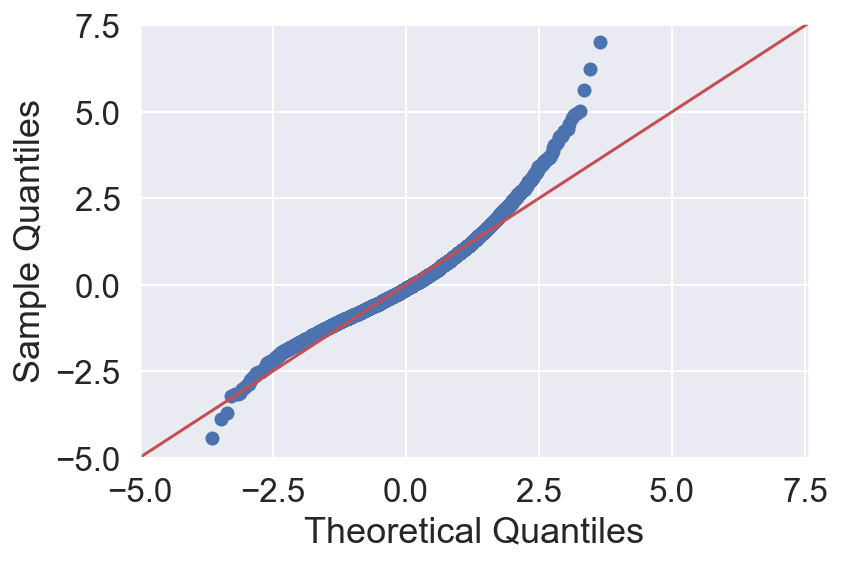

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.7063    136.1034
MAE     12.7676    12.2179       9.9678      8.8968
R^2      0.0000    -0.1012       0.3822      0.3197


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(3, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -30071.601

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3847      0.010    132.031      0.000       1.364       1.405
ar.L2         -0.3644      0.016    -23.087      0.000      -0.395      -0.333
ar.L3         -0.0288      0.007     -3.940      0.000      -0.043      -0.014
ma.L1         -0.9432      0.005   -194.651      0.000      -0.953      -0.934
ar.S.L24       0.9986      0.000   2239.927      0.000       0.998       0.999
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


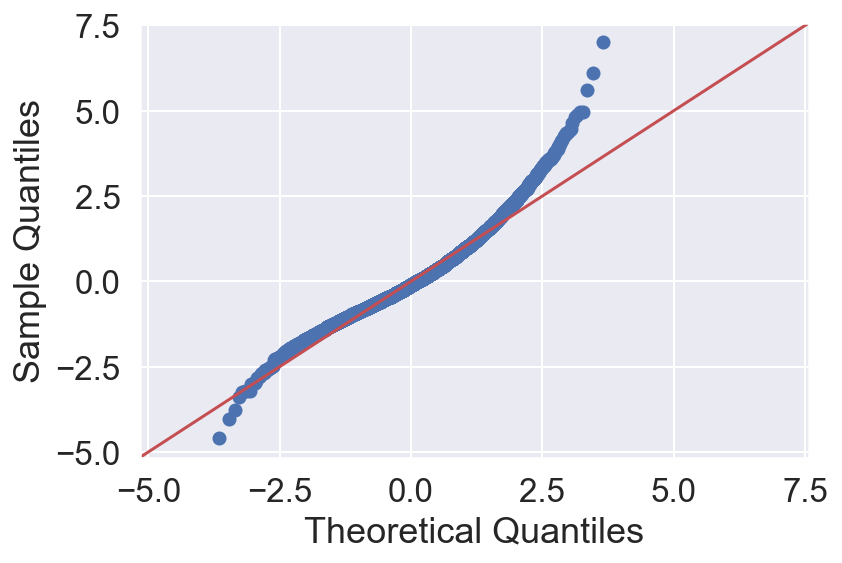

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.8575    136.5547
MAE     12.7676    12.2179      10.0104      8.9279
R^2      0.0000    -0.1012       0.3817      0.3174


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(3, 0, 2)x(1, 0, 1, 24)   Log Likelihood              -30080.838

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4475      0.010     43.805      0.000       0.427       0.468
ar.L2          0.9949      0.005    209.448      0.000       0.986       1.004
ar.L3         -0.4440      0.010    -44.198      0.000      -0.464      -0.424
ma.L1          0.0257      0.004      6.006      0.000       0.017       0.034
ma.L2         -0.9706      0.004   -232.185      0.000      -0.979      -0.962
ar.S.L24     

QUANTILE PLOT - ALL RESIDUALS


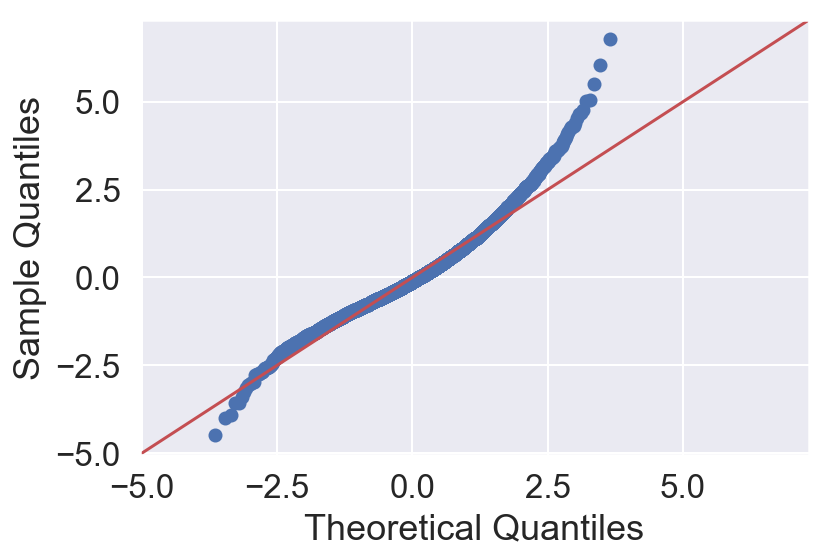

In [15]:
season=24
freq='H'
lag=[1,2,3]
ma=[1,2]

for olag in [1,2,3]:
    for oma in [1,2]:
        for solag in [1]:
            for soma in [1]:
                model_test(all_traffic.all_games_count,olag,oma,solag,soma,season,freq)

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.9288    136.6419
MAE     12.7676    12.2179      10.0390      8.8910
R^2      0.0000    -0.1012       0.3707      0.3170


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 1)x(2, 0, 2, 24)   Log Likelihood              -30128.914

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7052      0.014     52.117      0.000       0.679       0.732
ma.L1         -0.2801      0.019    -15.066      0.000      -0.317      -0.244
ar.S.L24       0.0476      0.122      0.391      0.696      -0.191       0.286
ar.S.L48       0.9514      0.122      7.812      0.000       0.713       1.190
ma.S.L24      -0.0166      0.119     -0.139      0.889      -0.250       0.217
ma.S.L48     

QUANTILE PLOT - ALL RESIDUALS


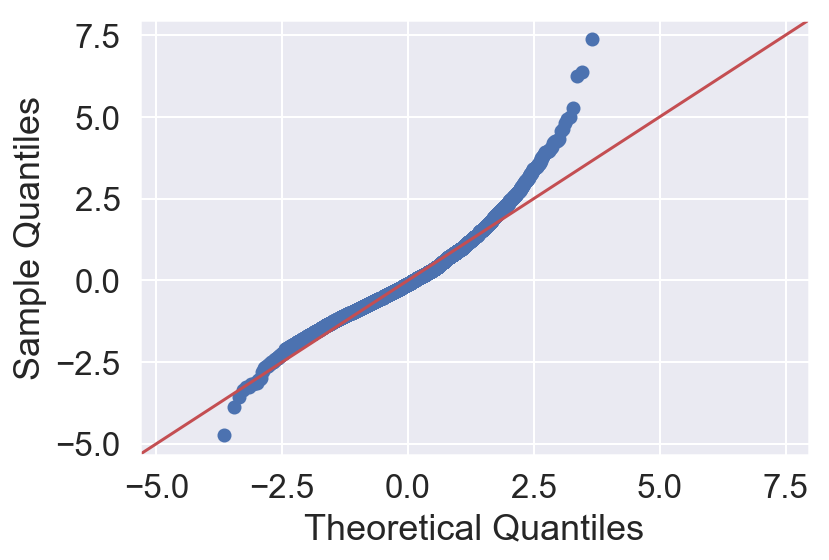

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     176.2514    135.5591
MAE     12.7676    12.2179      10.0919      8.9244
R^2      0.0000    -0.1012       0.3731      0.3224


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(1, 0, 2)x(2, 0, 2, 24)   Log Likelihood              -30109.998

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8575      0.008    103.923      0.000       0.841       0.874
ma.L1         -0.4218      0.013    -33.346      0.000      -0.447      -0.397
ma.L2         -0.1474      0.006    -26.790      0.000      -0.158      -0.137
ar.S.L24       0.0163      0.006      2.577      0.010       0.004       0.029
ar.S.L48       0.9835      0.006    155.941      0.000       0.971       0.996
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


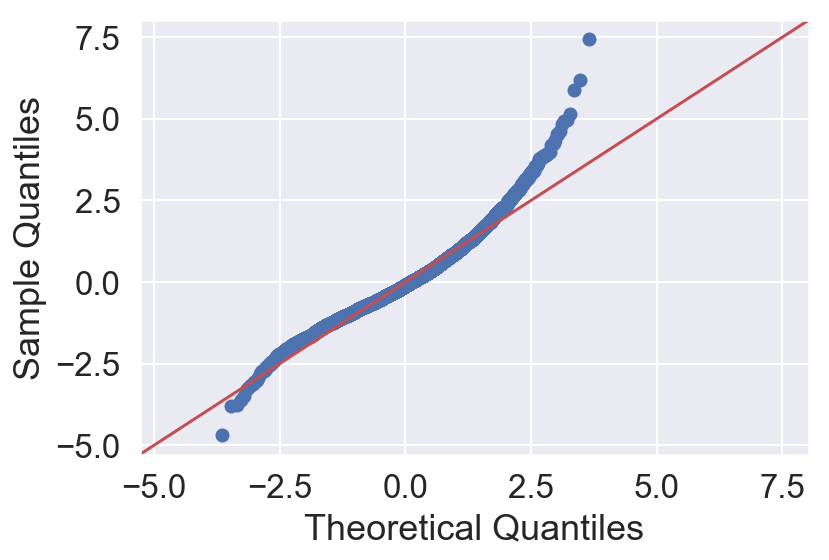

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.8925    136.1123
MAE     12.7676    12.2179       9.9787      8.8980
R^2      0.0000    -0.1012       0.3815      0.3196


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 1)x(2, 0, 2, 24)   Log Likelihood              -30076.946

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3888      0.013    102.885      0.000       1.362       1.415
ar.L2         -0.3991      0.012    -33.050      0.000      -0.423      -0.375
ma.L1         -0.9391      0.008   -115.378      0.000      -0.955      -0.923
ar.S.L24       0.1106      0.013      8.422      0.000       0.085       0.136
ar.S.L48       0.8862      0.013     66.215      0.000       0.860       0.912
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


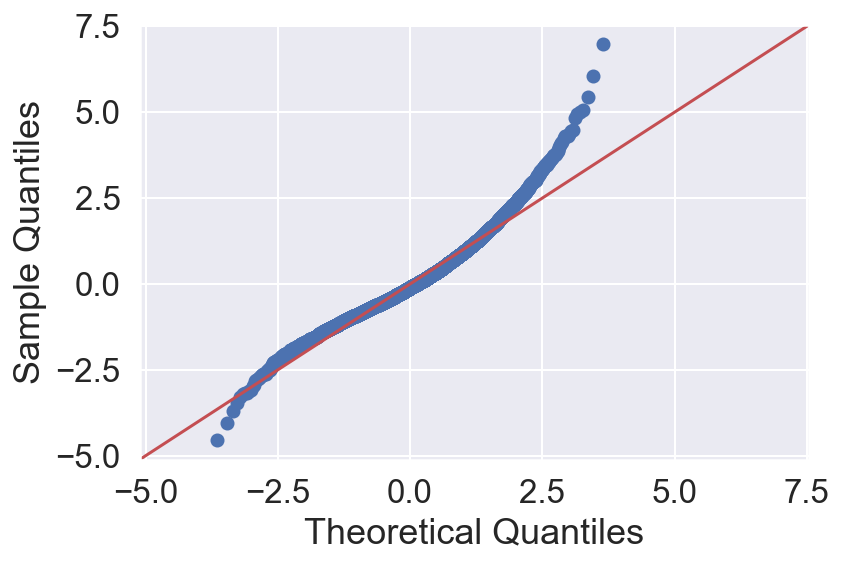

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     174.2863    135.9555
MAE     12.7676    12.2179       9.9866      8.8848
R^2      0.0000    -0.1012       0.3801      0.3204


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(2, 0, 2)x(2, 0, 2, 24)   Log Likelihood              -30081.938

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3801      0.040     34.674      0.000       1.302       1.458
ar.L2         -0.4040      0.036    -11.324      0.000      -0.474      -0.334
ma.L1         -0.9438      0.041    -22.916      0.000      -1.025      -0.863
ma.L2          0.0420      0.028      1.496      0.135      -0.013       0.097
ar.S.L24       0.0882      0.007     12.147      0.000       0.074       0.102
ar.S.L48     

QUANTILE PLOT - ALL RESIDUALS


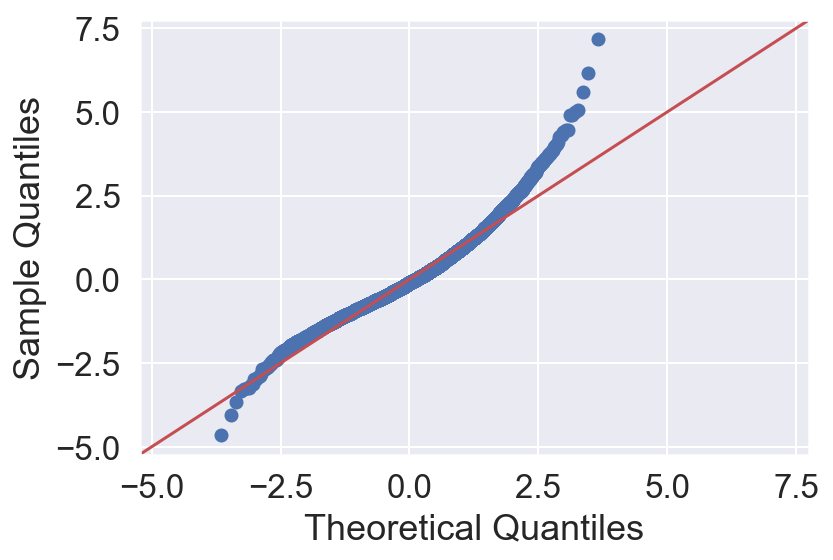

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     174.8009    135.7414
MAE     12.7676    12.2179      10.0070      8.8776
R^2      0.0000    -0.1012       0.3783      0.3215


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(3, 0, 1)x(2, 0, 2, 24)   Log Likelihood              -30085.225

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3013      0.026     49.525      0.000       1.250       1.353
ar.L2         -0.3167      0.018    -17.667      0.000      -0.352      -0.282
ar.L3         -0.0247      0.012     -2.024      0.043      -0.049      -0.001
ma.L1         -0.8691      0.024    -35.480      0.000      -0.917      -0.821
ar.S.L24       0.0586      0.020      2.935      0.003       0.019       0.098
ar.S.L48     

QUANTILE PLOT - ALL RESIDUALS


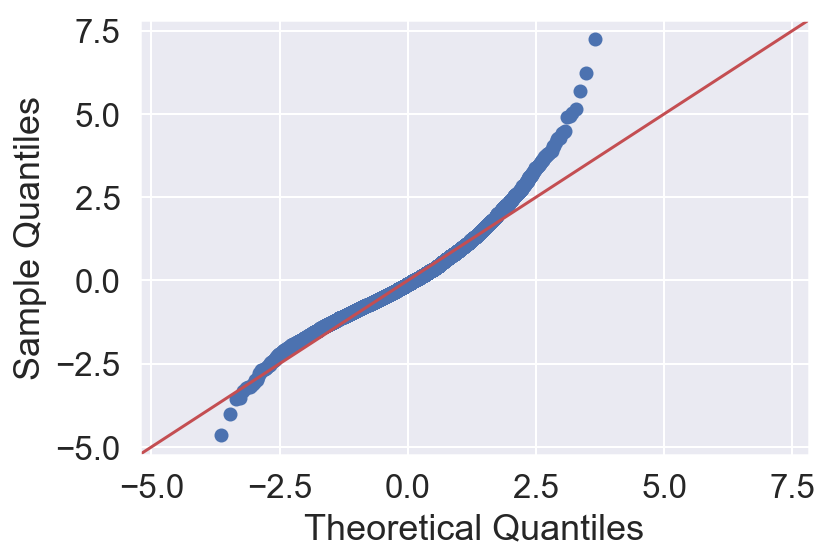

     Base_train  Base_test  Model_train  Model_test
MSE    281.1680   220.2957     173.9853    135.6474
MAE     12.7676    12.2179       9.9800      8.8828
R^2      0.0000    -0.1012       0.3812      0.3220


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 7565
Model:             SARIMAX(3, 0, 2)x(2, 0, 2, 24)   Log Likelihood              -30073.575

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4192      0.015     27.983      0.000       0.390       0.449
ar.L2          0.9867      0.013     77.632      0.000       0.962       1.012
ar.L3         -0.4219      0.012    -35.332      0.000      -0.445      -0.398
ma.L1          0.0424      0.011      3.869      0.000       0.021       0.064
ma.L2         -0.9517      0.010    -93.448      0.000      -0.972      -0.932
ar.S.L24     

QUANTILE PLOT - ALL RESIDUALS


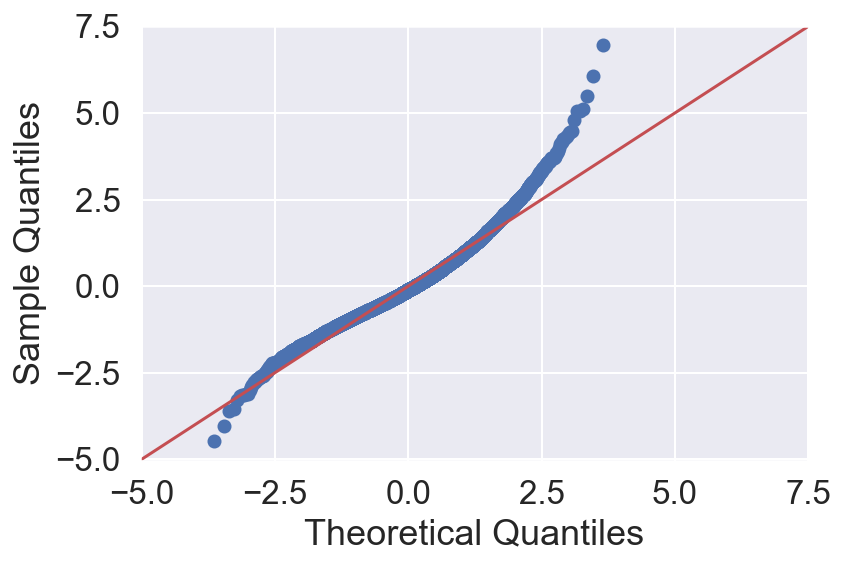

In [16]:
season=24
freq='H'
lag=[1,2,3]
ma=[1,2]

for olag in [1,2,3]:
    for oma in [1,2]:
        for solag in [2]:
            for soma in [2]:
                model_test(all_traffic.all_games_count,olag,oma,solag,soma,season,freq)

Correllogram shows significant likelilohhood of correlation between residuals when two moving averages are applied to the order of lag. 

We set at best approx .38 score on the train set and .32 on the test set.

We generally see over estimations; this is likely a response to some of the increased traffic assocated with pro on pro play in the training set.

Resample for 2 hour windows

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     546.4771    434.6656
MAE     22.6567    21.8987      17.7894     16.0466
R^2      0.0000    -0.1329       0.3772      0.2912


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 12)   Log Likelihood              -17207.991

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6046      0.023     25.826      0.000       0.559       0.651
ma.L1         -0.1753      0.030     -5.888      0.000      -0.234      -0.117
ar.S.L12       0.9994      0.000   3800.285      0.000       0.999       1.000
ma.S.L12      -0.9565      0.005   -186.108      0.000      -0.967      -0.946
sigma2       538.5050      9.394     57.326      0.000     520.094     556.916



QUANTILE PLOT - ALL RESIDUALS


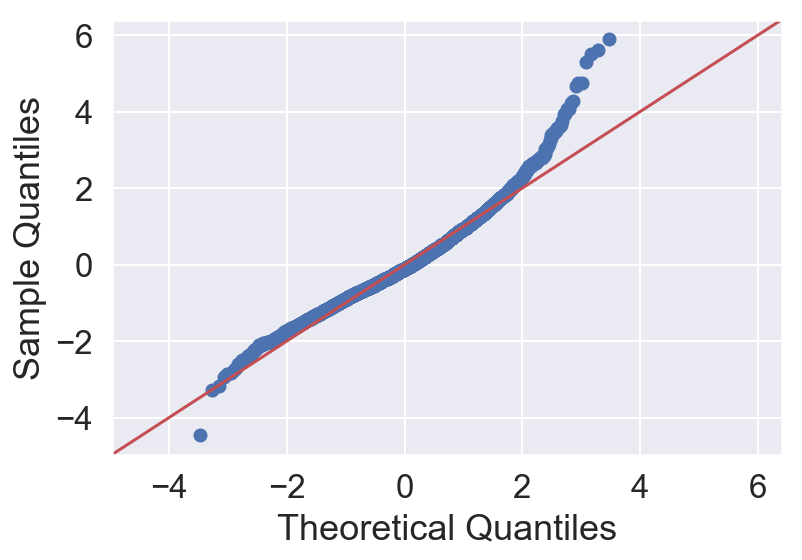

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     532.9031    436.9754
MAE     22.6567    21.8987      17.4851     16.1552
R^2      0.0000    -0.1329       0.3927      0.2874


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(2, 0, 1)x(1, 0, 1, 12)   Log Likelihood              -17173.343

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3918      0.015     91.262      0.000       1.362       1.422
ar.L2         -0.3947      0.015    -26.976      0.000      -0.423      -0.366
ma.L1         -0.9651      0.006   -159.177      0.000      -0.977      -0.953
ar.S.L12       0.9981      0.001   1372.923      0.000       0.997       1.000
ma.S.L12      -0.9713      0.005   -192.178      0.000      -0.981      -0.961
sigma2       

QUANTILE PLOT - ALL RESIDUALS


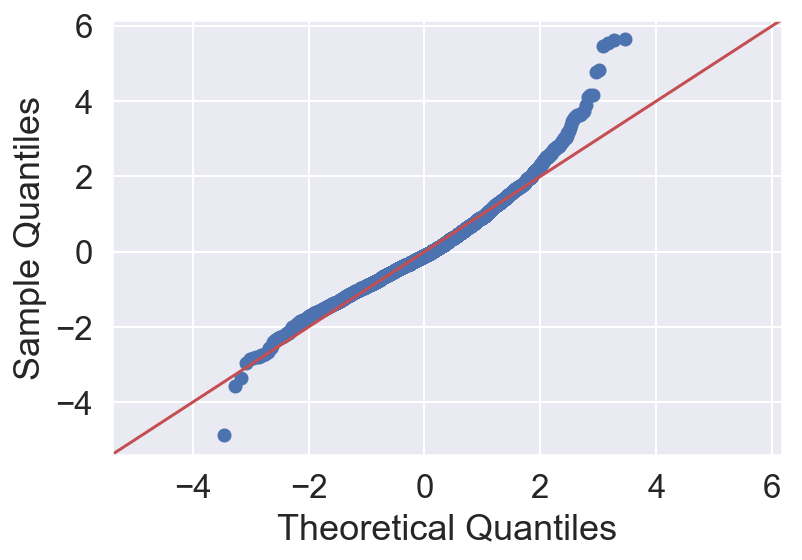

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     532.9511    435.8770
MAE     22.6567    21.8987      17.4840     16.1009
R^2      0.0000    -0.1329       0.3927      0.2892


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(3, 0, 1)x(1, 0, 1, 12)   Log Likelihood              -17172.524

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3697      0.018     74.807      0.000       1.334       1.406
ar.L2         -0.3614      0.018    -19.672      0.000      -0.397      -0.325
ar.L3         -0.0162      0.004     -4.217      0.000      -0.024      -0.009
ma.L1         -0.9525      0.010    -93.236      0.000      -0.973      -0.932
ar.S.L12       0.9979      0.001   1258.860      0.000       0.996       0.999
ma.S.L12     

QUANTILE PLOT - ALL RESIDUALS


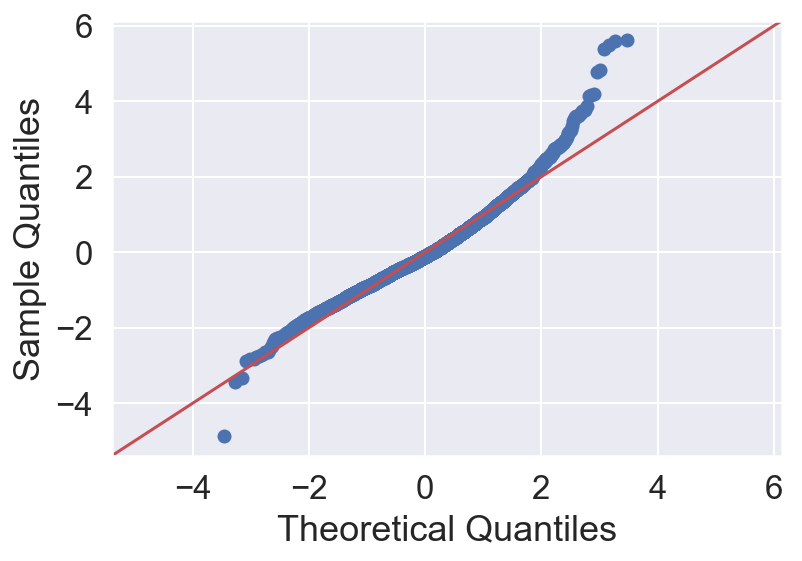

In [17]:
season=12
freq='2H'
lag=[1,2,3]
ma=[1,2]

for olag in [1,2,3]:
    for oma in [1]:
        for solag in [1]:
            for soma in [1]:
                model_test(all_traffic.all_games_count,olag,oma,solag,soma,season,freq)

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     541.4922    442.1786
MAE     22.6567    21.8987      17.6854     16.3036
R^2      0.0000    -0.1329       0.3829      0.2790


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(1, 0, 2)x(1, 0, 1, 12)   Log Likelihood              -17201.350

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9520      0.009    108.276      0.000       0.935       0.969
ma.L1         -0.5558      0.017    -33.568      0.000      -0.588      -0.523
ma.L2         -0.2549      0.017    -15.394      0.000      -0.287      -0.222
ar.S.L12       0.9993      0.000   3530.255      0.000       0.999       1.000
ma.S.L12      -0.9703      0.005   -205.528      0.000      -0.980      -0.961
sigma2       

QUANTILE PLOT - ALL RESIDUALS


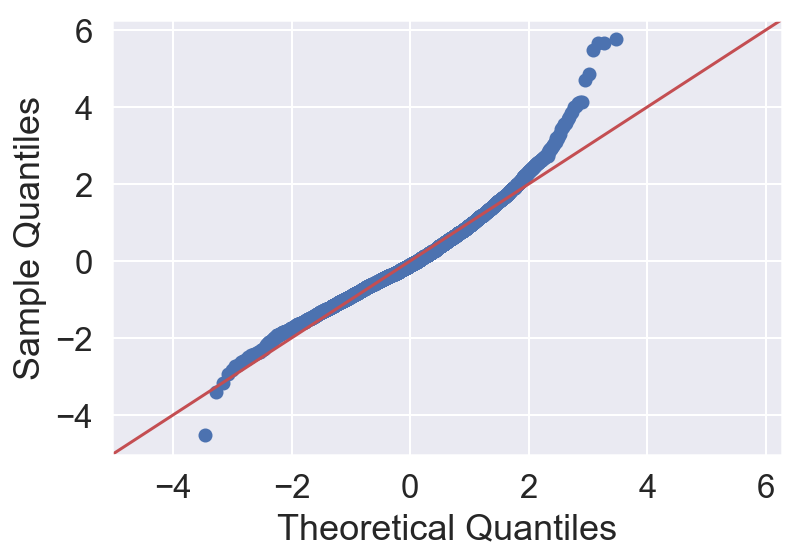

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     541.8356    445.3475
MAE     22.6567    21.8987      17.6539     16.3610
R^2      0.0000    -0.1329       0.3825      0.2738


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(1, 0, 2)x(1, 0, 2, 12)   Log Likelihood              -17205.254

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9872      0.004    266.863      0.000       0.980       0.994
ma.L1         -0.6033      0.014    -43.097      0.000      -0.631      -0.576
ma.L2         -0.2938      0.015    -19.840      0.000      -0.323      -0.265
ar.S.L12       0.9985      0.001   1648.898      0.000       0.997       1.000
ma.S.L12      -0.9301      0.014    -65.587      0.000      -0.958      -0.902
ma.S.L24     

QUANTILE PLOT - ALL RESIDUALS


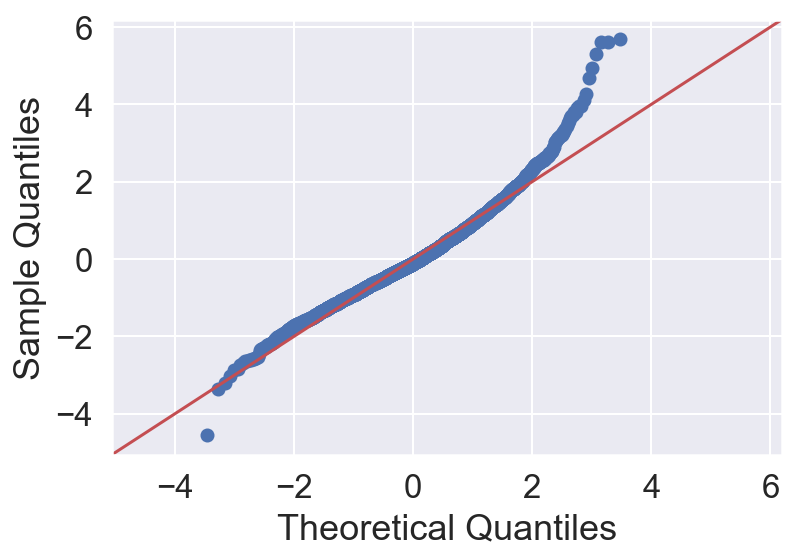

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     540.2624    440.1730
MAE     22.6567    21.8987      17.6882     16.2254
R^2      0.0000    -0.1329       0.3843      0.2822


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(1, 0, 2)x(2, 0, 1, 12)   Log Likelihood              -17196.193

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9408      0.011     85.455      0.000       0.919       0.962
ma.L1         -0.5459      0.018    -30.549      0.000      -0.581      -0.511
ma.L2         -0.2405      0.017    -14.040      0.000      -0.274      -0.207
ar.S.L12       1.0490      0.015     71.714      0.000       1.020       1.078
ar.S.L24      -0.0498      0.015     -3.405      0.001      -0.078      -0.021
ma.S.L12     

QUANTILE PLOT - ALL RESIDUALS


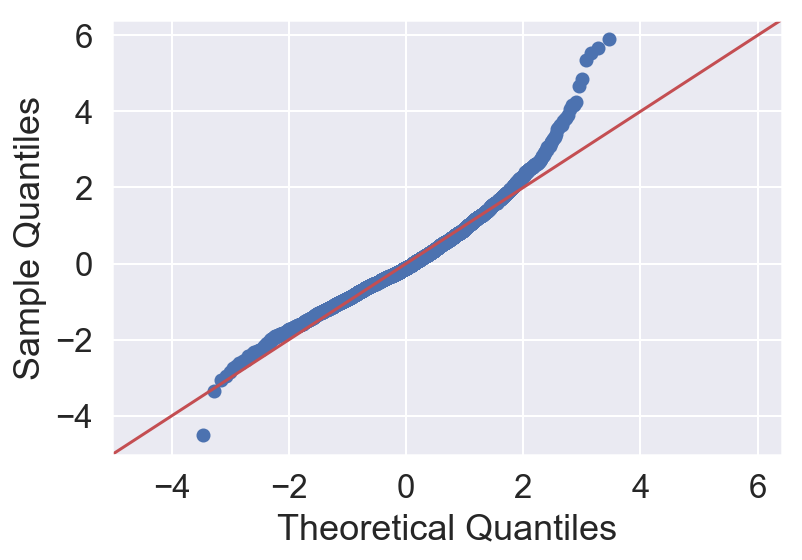

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     541.5007    442.4564
MAE     22.6567    21.8987      17.6862     16.3177
R^2      0.0000    -0.1329       0.3829      0.2785


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(1, 0, 2)x(2, 0, 2, 12)   Log Likelihood              -17201.717

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9556      0.008    113.983      0.000       0.939       0.972
ma.L1         -0.5620      0.016    -34.740      0.000      -0.594      -0.530
ma.L2         -0.2569      0.016    -15.576      0.000      -0.289      -0.225
ar.S.L12       0.0652      0.281      0.232      0.816      -0.486       0.616
ar.S.L24       0.9336      0.281      3.319      0.001       0.382       1.485
ma.S.L12     

QUANTILE PLOT - ALL RESIDUALS


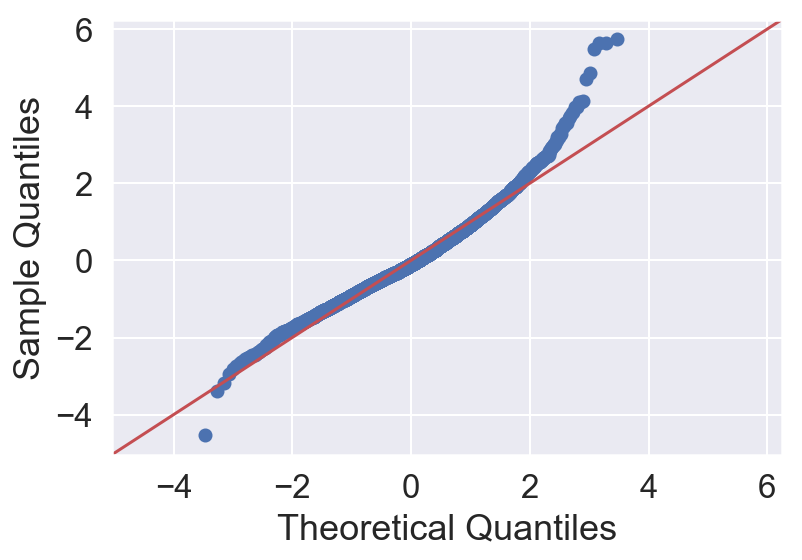

/anaconda3/lib/python3.7/site-packages/statsmodels/base/model.py:508: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     532.5622    435.8875
MAE     22.6567    21.8987      17.4933     16.1380
R^2      0.0000    -0.1329       0.3931      0.2892


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(2, 0, 2)x(1, 0, 1, 12)   Log Likelihood              -17171.635

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4289      0.017     83.721      0.000       1.395       1.462
ar.L2         -0.4325      0.016    -27.601      0.000      -0.463      -0.402
ma.L1         -1.0111      0.025    -40.620      0.000      -1.060      -0.962
ma.L2          0.0462      0.022      2.071      0.038       0.002       0.090
ar.S.L12       0.9986      0.001   1693.398      0.000       0.997       1.000
ma.S.L12     

QUANTILE PLOT - ALL RESIDUALS


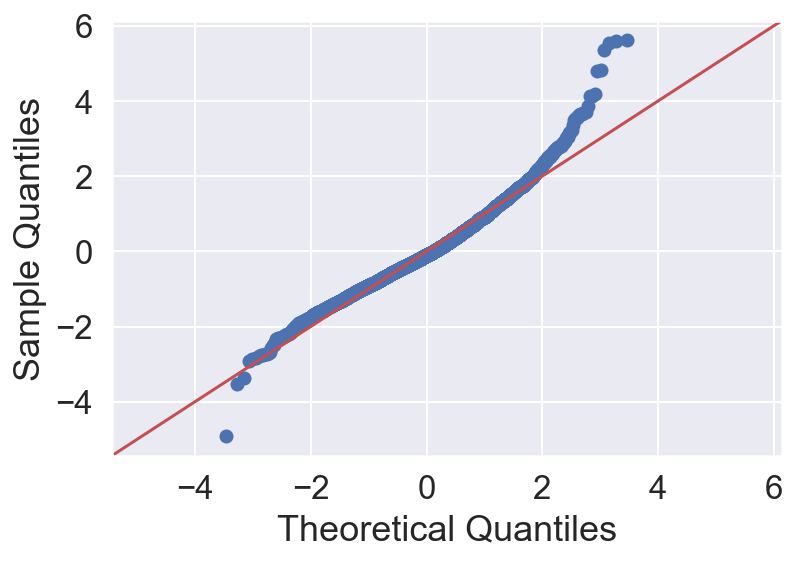

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     531.2949    434.2493
MAE     22.6567    21.8987      17.4792     16.0437
R^2      0.0000    -0.1329       0.3945      0.2919


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(2, 0, 2)x(1, 0, 2, 12)   Log Likelihood              -17166.182

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4390      0.012    122.472      0.000       1.416       1.462
ar.L2         -0.4430      0.011    -39.576      0.000      -0.465      -0.421
ma.L1         -1.0245      0.007   -151.448      0.000      -1.038      -1.011
ma.L2          0.0561      0.006      9.111      0.000       0.044       0.068
ar.S.L12       0.9982      0.001   1336.270      0.000       0.997       1.000
ma.S.L12     

QUANTILE PLOT - ALL RESIDUALS


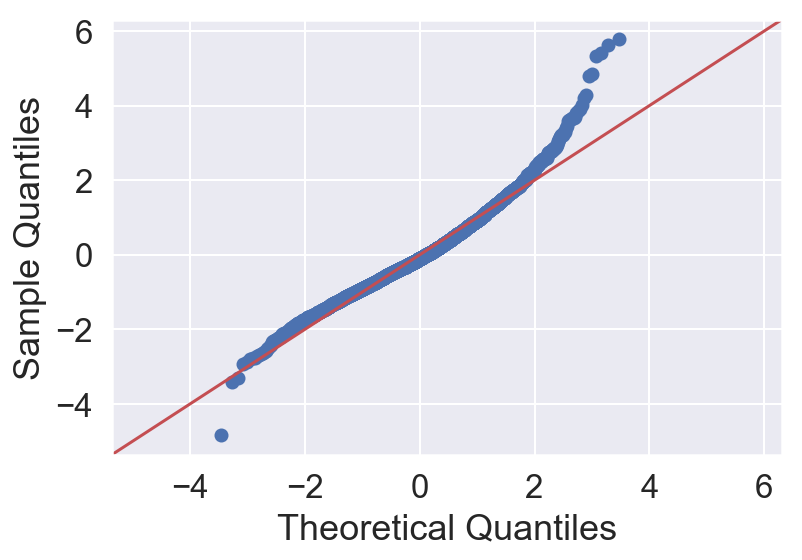

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     531.1004    434.2214
MAE     22.6567    21.8987      17.4855     16.0609
R^2      0.0000    -0.1329       0.3948      0.2919


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(2, 0, 2)x(2, 0, 1, 12)   Log Likelihood              -17165.242

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4350      0.038     37.765      0.000       1.361       1.509
ar.L2         -0.4386      0.037    -11.777      0.000      -0.512      -0.366
ma.L1         -1.0210      0.042    -24.468      0.000      -1.103      -0.939
ma.L2          0.0529      0.038      1.398      0.162      -0.021       0.127
ar.S.L12       1.0539      0.003    332.523      0.000       1.048       1.060
ar.S.L24     

QUANTILE PLOT - ALL RESIDUALS


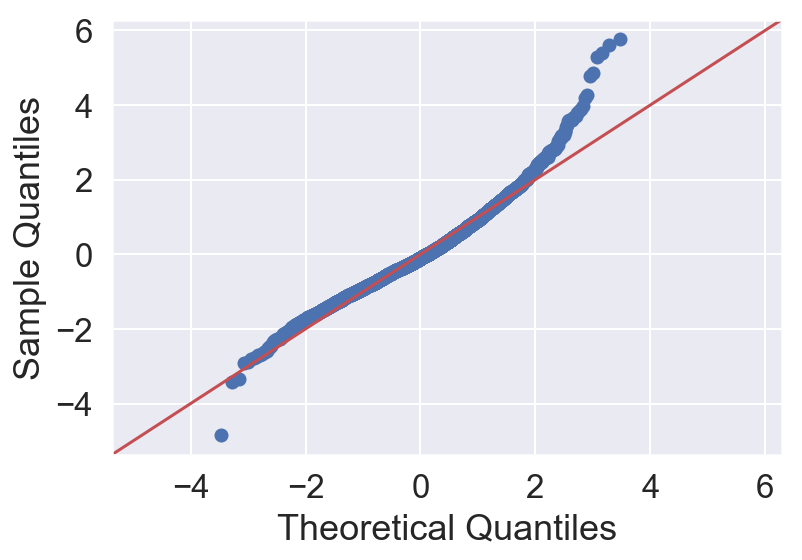

     Base_train  Base_test  Model_train  Model_test
MSE    877.5137   694.7591     532.5689    435.1133
MAE     22.6567    21.8987      17.4935     16.1080
R^2      0.0000    -0.1329       0.3931      0.2905


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                    all_games_count   No. Observations:                 3783
Model:             SARIMAX(2, 0, 2)x(2, 0, 2, 12)   Log Likelihood              -17171.628

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4064      0.042     33.600      0.000       1.324       1.488
ar.L2         -0.4126      0.041    -10.170      0.000      -0.492      -0.333
ma.L1         -0.9915      0.045    -21.973      0.000      -1.080      -0.903
ma.L2          0.0337      0.039      0.853      0.393      -0.044       0.111
ar.S.L12       0.1134      0.009     12.528      0.000       0.096       0.131
ar.S.L24     

QUANTILE PLOT - ALL RESIDUALS


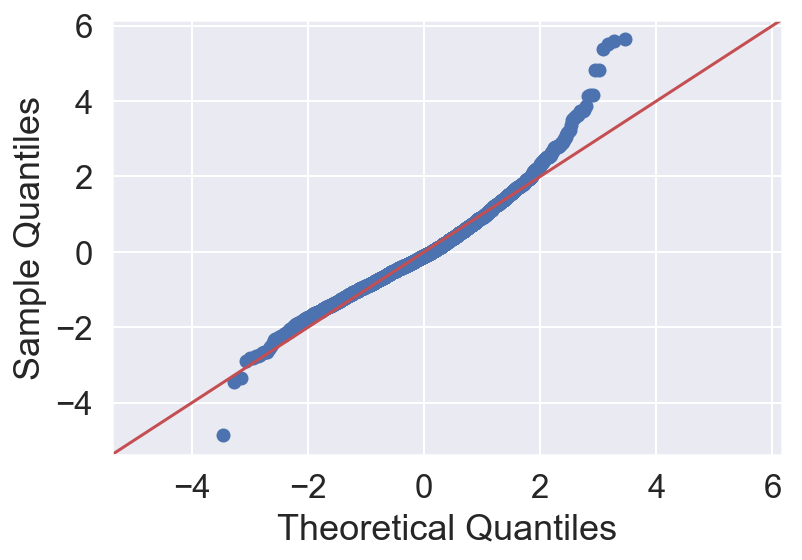

ValueError: Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.

In [18]:
season=12
freq='2H'

for olag in [1,2,3]:
    for oma in [2]:
        for solag in [1,2]:
            for soma in [1,2]:
                model_test(all_traffic.all_games_count,olag,oma,solag,soma,season,freq)

In [ ]:
# We do worse on the test set with 2 hour window, maybe the reduced sample size is harming the models accuracy. Up to almost .4 on test set

     Base_train  Base_test  Model_train  Model_test
MSE   2749.8037  2114.3135    1719.6802   1188.5572
MAE     39.8170    38.4881      31.5231     25.9591
R^2      0.0000    -0.1885       0.3746      0.3319


STATESPACE MODEL RESULTS AND DIAGNOSTICS
Dep. Variable:                   all_games_count   No. Observations:                 1892
Model:             SARIMAX(1, 0, 1)x(2, 0, 1, 6)   Log Likelihood               -9668.901

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5005      0.048     10.373      0.000       0.406       0.595
ma.L1         -0.1433      0.055     -2.625      0.009      -0.250      -0.036
ar.S.L6        1.1169      0.020     56.108      0.000       1.078       1.156
ar.S.L12      -0.1172      0.020     -5.898      0.000      -0.156      -0.078
ma.S.L6       -0.9582      0.007   -132.117      0.000      -0.972      -0.944
sigma2      168

QUANTILE PLOT - ALL RESIDUALS


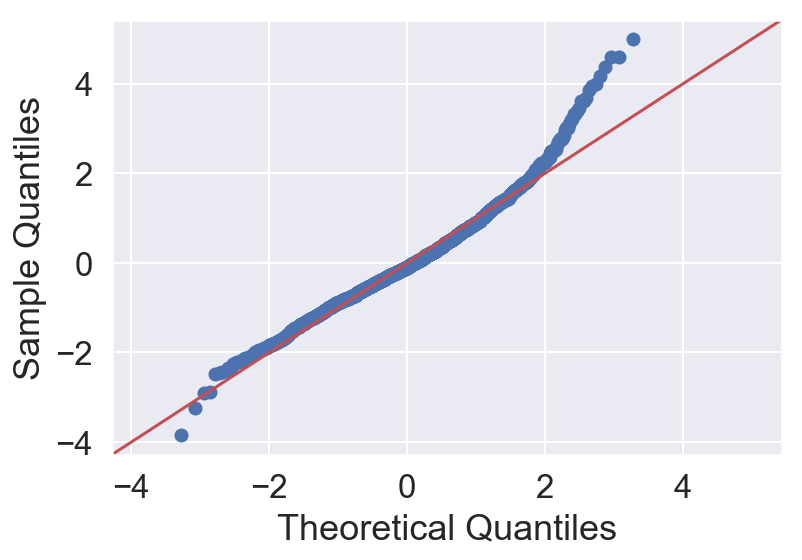

ValueError: Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.

In [19]:
season=6
freq='4H'
lag=[1,2,3]
ma=[1,2]

for olag in [1,2]:
    for oma in [1]:
        for solag in [2]:
            for soma in [1]:
                model_test(all_traffic.all_games_count,olag,oma,solag,soma,season,freq)